# Raman Spectroscopy Decomposition

# Introduction

Once components in a mixture Raman spectra have been identified and assigned, and psudo-Voigt curve fiting has been completed the next step is to compare pure component calibration (or non-decomposing, non-reacting) area under peaks to experimental data. From this comparision one will be able to deterimine:
1. is decomposition occuring?

and if it is then: 
2. calculate the amount of molar decomposition 

This calculation can be completed by comparing the area value of the experimental mixture Raman spectra to the pure component calibration Raman spectra area.

# Pre-step (1/2): Import Modules

In [1]:
#initial imports
import os
import h5py
import pandas as pd
import matplotlib.pyplot as plt
import math
import numpy as np
from scipy import interpolate
import lineid_plot
import array 
from ramandecompy import spectrafit
from ramandecompy import peakidentify
from ramandecompy import dataprep
from ramandecompy import dataimport
from ramandecompy import datavis
from ramandecompy import machine_learning

# Pre-step (2/2): Import Calibration / Single Component Raman Spectra Data
### Note: Data structure is HDF5

In [2]:
dataprep.new_hdf5('calibration_data2')

dataprep.add_calibration('calibration_data2.hdf5',
                          '../ramandecompy/tests/test_files/Hydrogen_Baseline_Calibration.xlsx',
                          label='Hydrogen')
dataprep.add_calibration('calibration_data2.hdf5',
                         '../ramandecompy/tests/test_files/CarbonMonoxide_Baseline_Calibration.xlsx',
                         label='CarbonMonoxide')
dataprep.add_calibration('calibration_data2.hdf5','../ramandecompy/tests/test_files/CO2_100wt%.csv',label='CO2')
dataprep.add_calibration('calibration_data2.hdf5','../ramandecompy/tests/test_files/water.xlsx',label='H2O')
dataprep.add_calibration('calibration_data2.hdf5','../ramandecompy/tests/test_files/sapphire.xlsx',label='sapphire')
dataprep.add_calibration('calibration_data2.hdf5','../ramandecompy/tests/test_files/FormicAcid_3_6percent.xlsx',label='FormicAcid')


Data from ../ramandecompy/tests/test_files/Hydrogen_Baseline_Calibration.xlsx fit with compound pseudo-Voigt model.
     Results saved to calibration_data2.hdf5.
Data from ../ramandecompy/tests/test_files/CarbonMonoxide_Baseline_Calibration.xlsx fit with compound pseudo-Voigt model.
     Results saved to calibration_data2.hdf5.
Data from ../ramandecompy/tests/test_files/CO2_100wt%.csv fit with compound pseudo-Voigt model.
     Results saved to calibration_data2.hdf5.
Data from ../ramandecompy/tests/test_files/water.xlsx fit with compound pseudo-Voigt model.
     Results saved to calibration_data2.hdf5.
Data from ../ramandecompy/tests/test_files/sapphire.xlsx fit with compound pseudo-Voigt model.
     Results saved to calibration_data2.hdf5.
Data from ../ramandecompy/tests/test_files/FormicAcid_3_6percent.xlsx fit with compound pseudo-Voigt model.
     Results saved to calibration_data2.hdf5.


In [3]:
dataprep.view_hdf5('calibration_data2.hdf5') #viewing to see that the data was imported

**** calibration_data2.hdf5 ****
CO2
|    Peak_01
|    Peak_02
|    counts
|    residuals
|    wavenumber
CarbonMonoxide
|    Peak_01
|    counts
|    residuals
|    wavenumber
FormicAcid
|    Peak_01
|    Peak_02
|    Peak_03
|    Peak_04
|    Peak_05
|    Peak_06
|    counts
|    residuals
|    wavenumber
H2O
|    Peak_01
|    Peak_02
|    counts
|    residuals
|    wavenumber
Hydrogen
|    Peak_01
|    Peak_02
|    Peak_03
|    Peak_04
|    counts
|    residuals
|    wavenumber
sapphire
|    Peak_01
|    Peak_02
|    Peak_03
|    Peak_04
|    counts
|    residuals
|    wavenumber


In [4]:
dataprep.view_hdf5('dataimport_ML_df-Copy1.hdf5') #viewing to see that that experimental data is imported correctly

**** dataimport_ML_df-Copy1.hdf5 ****
300C
|    25s
|    |    Peak_01
|    |    Peak_02
|    |    Peak_03
|    |    Peak_04
|    |    Peak_05
|    |    Peak_06
|    |    Peak_07
|    |    Peak_08
|    |    Peak_09
|    |    Peak_10
|    |    Peak_11
|    |    Peak_12
|    |    Peak_13
|    |    Peak_14
|    |    Peak_15
|    |    Peak_16
|    |    counts
|    |    residuals
|    |    wavenumber
|    35s
|    |    Peak_01
|    |    Peak_02
|    |    Peak_03
|    |    Peak_04
|    |    Peak_05
|    |    Peak_06
|    |    Peak_07
|    |    Peak_08
|    |    Peak_09
|    |    Peak_10
|    |    Peak_11
|    |    Peak_12
|    |    Peak_13
|    |    Peak_14
|    |    Peak_15
|    |    Peak_16
|    |    counts
|    |    residuals
|    |    wavenumber
|    45s
|    |    Peak_01
|    |    Peak_02
|    |    Peak_03
|    |    Peak_04
|    |    Peak_05
|    |    Peak_06
|    |    Peak_07
|    |    Peak_08
|    |    Peak_09
|    |    Peak_10
|    |    Peak_11
|    |    Peak_12
|    |    Peak_13
|   

|    |    Peak_07
|    |    Peak_08
|    |    Peak_09
|    |    Peak_10
|    |    Peak_11
|    |    Peak_12
|    |    Peak_13
|    |    counts
|    |    residuals
|    |    wavenumber
|    5s
|    |    Peak_01
|    |    Peak_02
|    |    Peak_03
|    |    Peak_04
|    |    Peak_05
|    |    Peak_06
|    |    Peak_07
|    |    Peak_08
|    |    Peak_09
|    |    Peak_10
|    |    Peak_11
|    |    Peak_12
|    |    Peak_13
|    |    Peak_14
|    |    Peak_15
|    |    Peak_16
|    |    Peak_17
|    |    Peak_18
|    |    Peak_19
|    |    Peak_20
|    |    Peak_21
|    |    counts
|    |    residuals
|    |    wavenumber
|    75s
|    |    Peak_01
|    |    Peak_02
|    |    Peak_03
|    |    Peak_04
|    |    Peak_05
|    |    Peak_06
|    |    Peak_07
|    |    Peak_08
|    |    Peak_09
|    |    Peak_10
|    |    Peak_11
|    |    Peak_12
|    |    Peak_13
|    |    Peak_14
|    |    Peak_15
|    |    Peak_16
|    |    Peak_17
|    |    Peak_18
|    |    counts
|    |    residuals
| 

# Step 1: Import Experimental Data Sets
The first thing is to put experimental data into a hdf5 file (this file will end up being used to identify peaks)

With multiple files in a directory/ many data sets it is usefull to loop over all files in the directory to add versus adding one by one. The code to loop came from a stackoverflow comment: `https://stackoverflow.com/questions/10377998/how-can-i-iterate-over-files-in-a-given-directory`

A good resource for HDF5 file types in general is: `http://docs.h5py.org/en/stable/`


### Note: If experimental data is already collected you don't have to complete this step (which can be time consuming for large data sets) a second time

In [ ]:
#dataprep.new_hdf5('dataprep_experiment') #comment this line out once made for the first time so an error isn't given saying that the file already exists
#directory = '/Users/elizabeth/Desktop/raman-spectra-decomp-analysis/ramandecompy/tests/test_files/' #defining directory for data
#dataprep.view_hdf5('dataprep_experimental.hdf5')

#base_dir = '../ramandecompy/tests/test_files/'

#for filename in os.listdir(directory):
#    if filename.startswith('FA_') and filename.endswith('.csv'):
#        locationandfile = directory + filename
#        dataprep.add_experiment('dataprep_experimental.hdf5', locationandfile)
#        continue
#    else:
#        continue
#return

#FOR CALIBRATION DATA MASS ADD

#dataprep.new_hdf5('dataprep_experiment') #comment this line out once made for the first time so an error isn't given saying that the file already exists
#directory = '/Users/elizabeth/Desktop/raman-spectra-decomp-analysis/ramandecompy/tests/test_files/' #defining directory for data
#


In [ ]:
#type(filename) #checking the type (making sure is a string) for file name

In [ ]:
#dataprep.view_hdf5('dataimport_ML_df-Copy1.hdf5') #making sure the loop did its job and all data is correctly imported 
#comment out this to not see the long list

# Step 2: Define substance of interest
The second step is to determine if the desired speciecies in the spectra is present, and if it is then if it has decomposed (decreased/changed) from the defined calibration area. 

At this point this will be done by the user knowing where the approximate location of the peak for the substance that is of interest. 

Given the user center peak wavelength location input the code will go through the calibration data and for a peak with a center at the defined location (ith some tolerance of +/- 10 cm^-1) will take the area of that curve and store it as a variable.

In [5]:
#getting peak information for Formic Acid 

data1 = h5py.File('calibration_data2.hdf5', 'r+')
# then specify the peak
peak_01 = list(data1['FormicAcid/Peak_01'][0])
#peak_01s = data1['FormicAcid/Peak_01']
# you put list because otherwise it just saves it as a h5py.dataset or something and lists are more familiar. Then peak_01 will be a list containing the 7 elements of the Peak_01 dataset
print(peak_01)

type(peak_01)
#print(type(peak_01s))

[0.8169042708364402, 19.214441327324774, 707.31, 12328.743413166403, 38.42888265464955, 222.02789635876206, 12169.857127386516]


list

In [6]:
peak_01[4] #Looking for area under the curve value for the first peak


38.42888265464955

In [7]:
peak_01[2]

707.31

### Figuring out what peak from Formic Acid to use/ are close to other observed peaks used in analysis
For Formic Acid, prior reports of the wavenumbers of significant Raman Peaks (cm^-1) were at:
- 712
- 1219
- 1400
- 1714
- 2943

We are now going to go through the peaks identified in the calibration file and see if the peak center's match up with the literature values.

In [8]:
peak_01 = list(data1['FormicAcid/Peak_01'][0])
print(peak_01[2])

707.31


In [9]:
peak_02 = list(data1['FormicAcid/Peak_02'][0])
print(peak_02[2])

1055.9


In [10]:
peak_03 = list(data1['FormicAcid/Peak_03'][0])
print(peak_03[2])

1219.5


In [11]:
peak_04 = list(data1['FormicAcid/Peak_04'][0])
print(peak_04[2])

1400.1


In [12]:
peak_05 = list(data1['FormicAcid/Peak_05'][0])
print(peak_05[2])
print(peak_05[6]) # AUC

1716.7
35996.771380330516


In [13]:
peak_06 = list(data1['FormicAcid/Peak_06'][0])
print(peak_06[2])

2940.6


### All peaks previously reported are identified in the calibration file within +/- 5 wavenumbers
Note: There is an additional peak identified at 1055, but it is hypothesized that this peak may not be easily identified from other components with similar wavenumbers and/or with the amplitude of the peak being smaller then peaks of formic acid at the other wavenumbers this could be why it isn't identifed in literature. 

For this example the peak occuring at ~707 cm^-1 (peak_01) will be used for molar concentration calculations because it is isolated enough within the mixture spectra to be identified the most consistently in the experimental data set. More about this decision can be seen in **Step 3**. 

In [14]:
FA_cal_area = peak_01[6]
print(FA_cal_area) #printing the area of the curve for the calibration data set of the chosen peak

12169.857127386516


## Step 3: Define presence of substance in experimental data

Then for that same center peak wavelength location input it will identify the presence of the peak (if it is there) in the experimental data and area for that peak and store it as a second variable.


In [15]:
#define filenames
hdf5_calfilename = 'calibration_data2.hdf5' #update to hdf5_calfilename
hdf5_expfilename = 'dataimport_ML_df-Copy1.hdf5'

cal_key_list = machine_learning.keyfinder(hdf5_calfilename)
exp_key_list = machine_learning.keyfinder(hdf5_expfilename)

In [16]:
print(cal_key_list) #checking the calibration key list

['CO2/Peak_01', 'CO2/Peak_02', 'CO2/counts', 'CO2/residuals', 'CO2/wavenumber', 'CarbonMonoxide/Peak_01', 'CarbonMonoxide/counts', 'CarbonMonoxide/residuals', 'CarbonMonoxide/wavenumber', 'FormicAcid/Peak_01', 'FormicAcid/Peak_02', 'FormicAcid/Peak_03', 'FormicAcid/Peak_04', 'FormicAcid/Peak_05', 'FormicAcid/Peak_06', 'FormicAcid/counts', 'FormicAcid/residuals', 'FormicAcid/wavenumber', 'H2O/Peak_01', 'H2O/Peak_02', 'H2O/counts', 'H2O/residuals', 'H2O/wavenumber', 'Hydrogen/Peak_01', 'Hydrogen/Peak_02', 'Hydrogen/Peak_03', 'Hydrogen/Peak_04', 'Hydrogen/counts', 'Hydrogen/residuals', 'Hydrogen/wavenumber', 'sapphire/Peak_01', 'sapphire/Peak_02', 'sapphire/Peak_03', 'sapphire/Peak_04', 'sapphire/counts', 'sapphire/residuals', 'sapphire/wavenumber']


In [17]:
print(exp_key_list) #checking the experimental key list

['300C/25s', '300C/35s', '300C/45s', '300C/55s', '300C/65s', '320C/25s', '320C/30s', '320C/40s', '320C/50s', '320C/60s', '340C/20s', '340C/30s', '340C/40s', '340C/50s', '340C/60s', '360C/20s', '360C/30s', '360C/40s', '360C/50s', '360C/60s', '380C/15s', '380C/25s', '380C/35s', '380C/45s', '380C/55s', '390C/10s', '390C/15s', '390C/20s', '390C/25s', '390C/30s', '400C/10s', '400C/125s', '400C/15s', '400C/5s', '400C/75s', '410C/10s', '410C/125s', '410C/15s', '410C/5s', '410C/75s', '420C/10s', '420C/5s', '420C/625s', '420C/75s', '420C/875s', '430C/4s', '430C/5s', '430C/6s', '430C/7s', '430C/8s']


In [18]:
#checking the length of the experimental key list to know how many experimental conditioned spectra is given
len(exp_key_list) 

50

The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


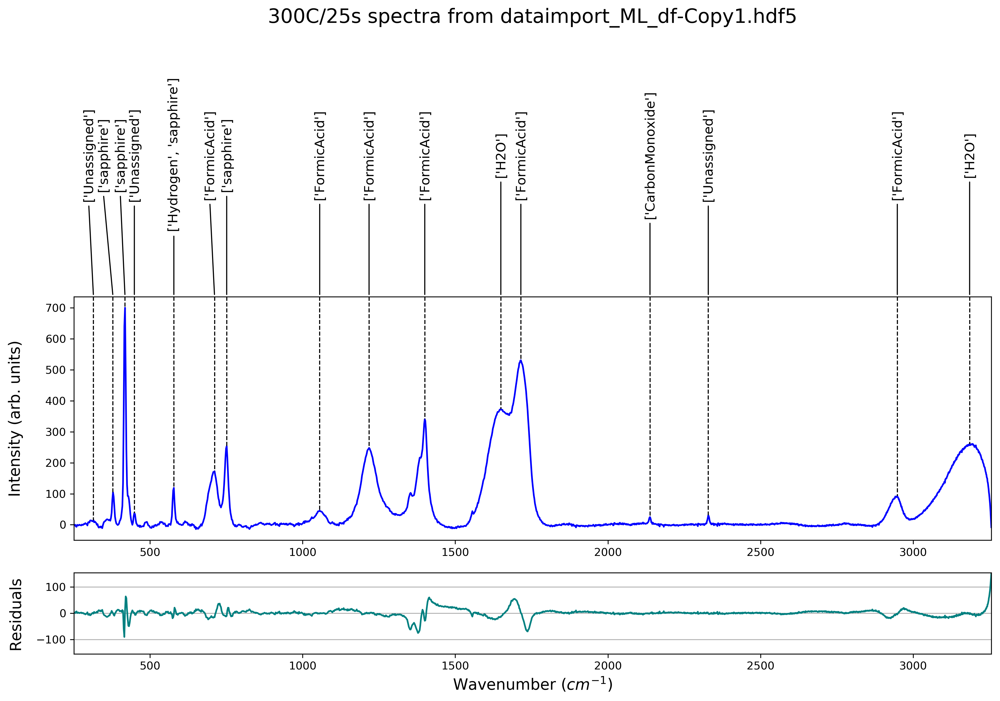

{'CO2': 0.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 100.0, 'Hydrogen': 25.0, 'sapphire': 100.0}


In [19]:
#checking peak identify for the first peak in the experimental data set
df = peakidentify.peak_assignment(hdf5_expfilename, '300C/25s', hdf5_calfilename, 10)

The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


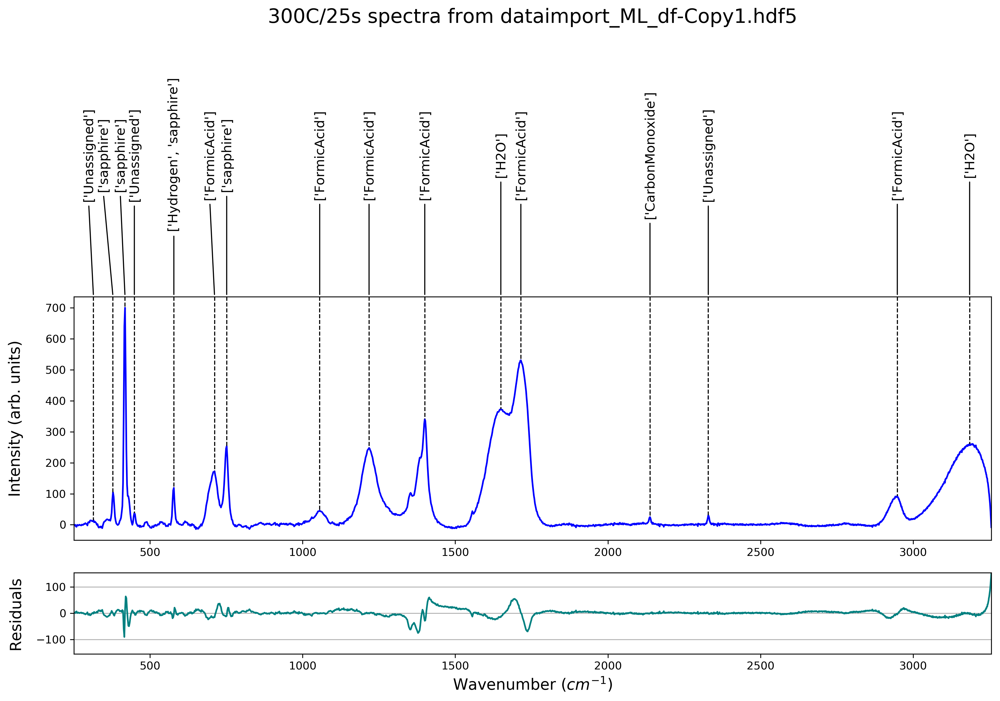

{'CO2': 0.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 100.0, 'Hydrogen': 25.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


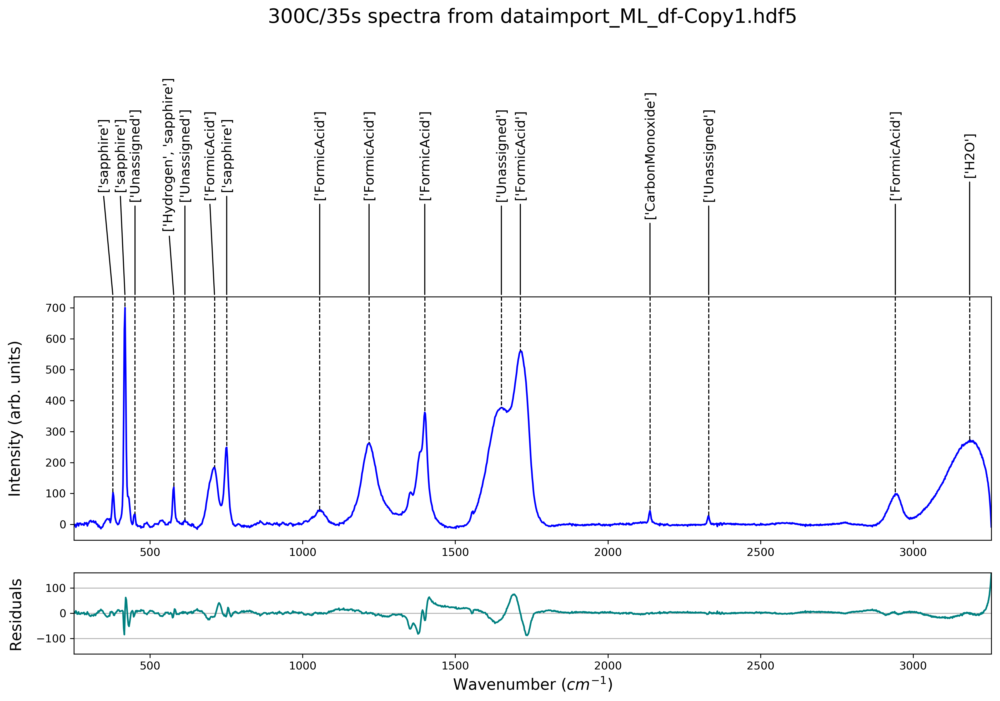

{'CO2': 0.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 50.0, 'Hydrogen': 25.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


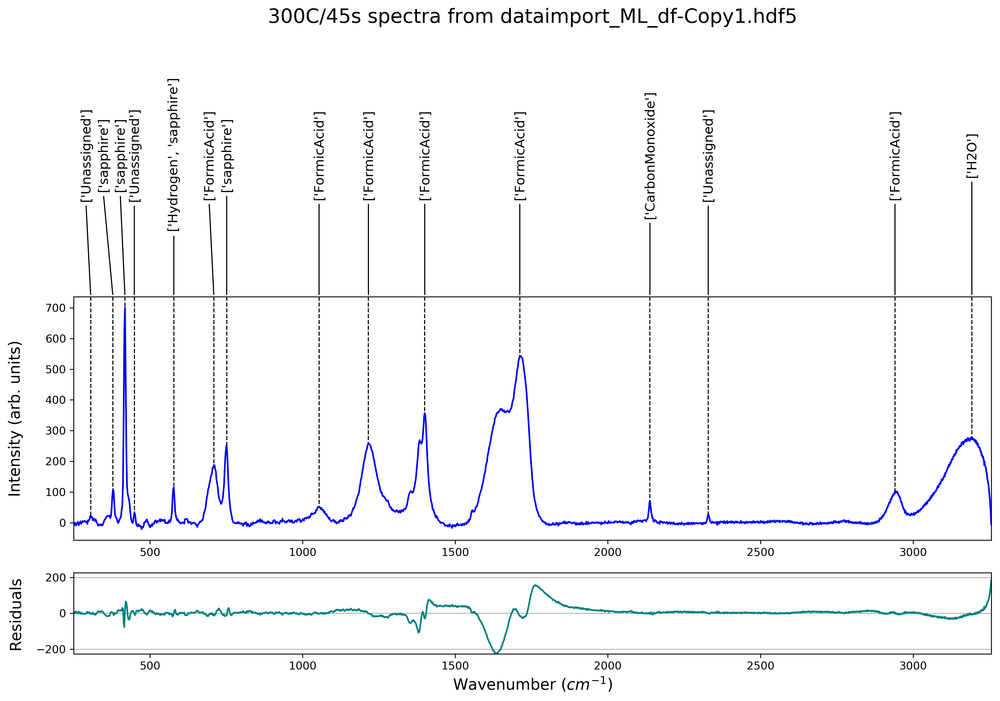

{'CO2': 0.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 50.0, 'Hydrogen': 25.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


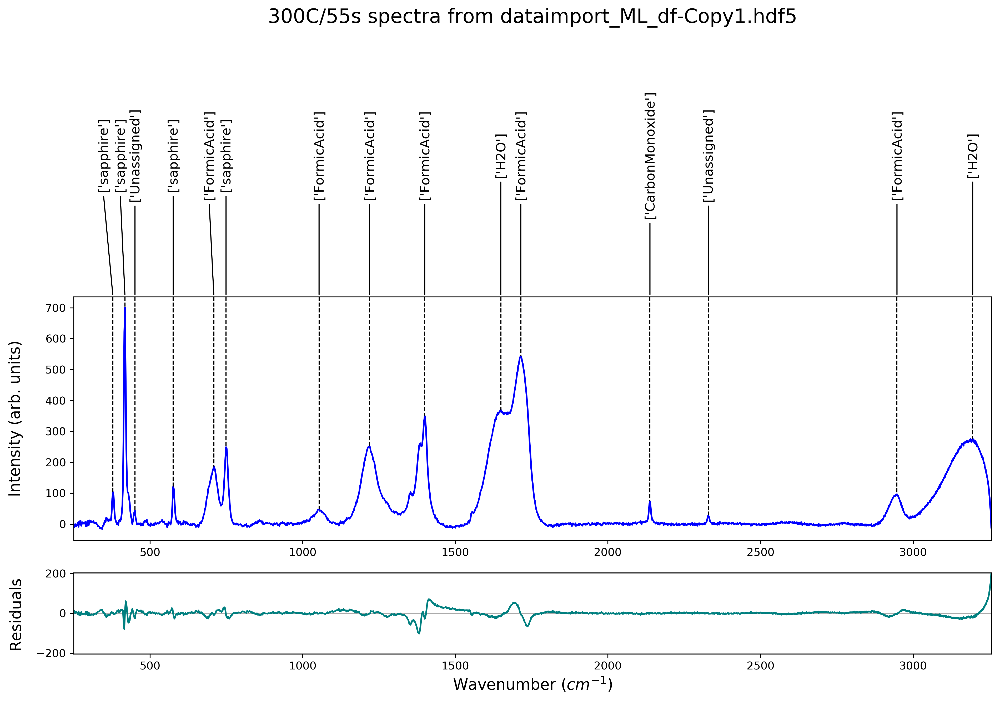

{'CO2': 0.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 100.0, 'Hydrogen': 0.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


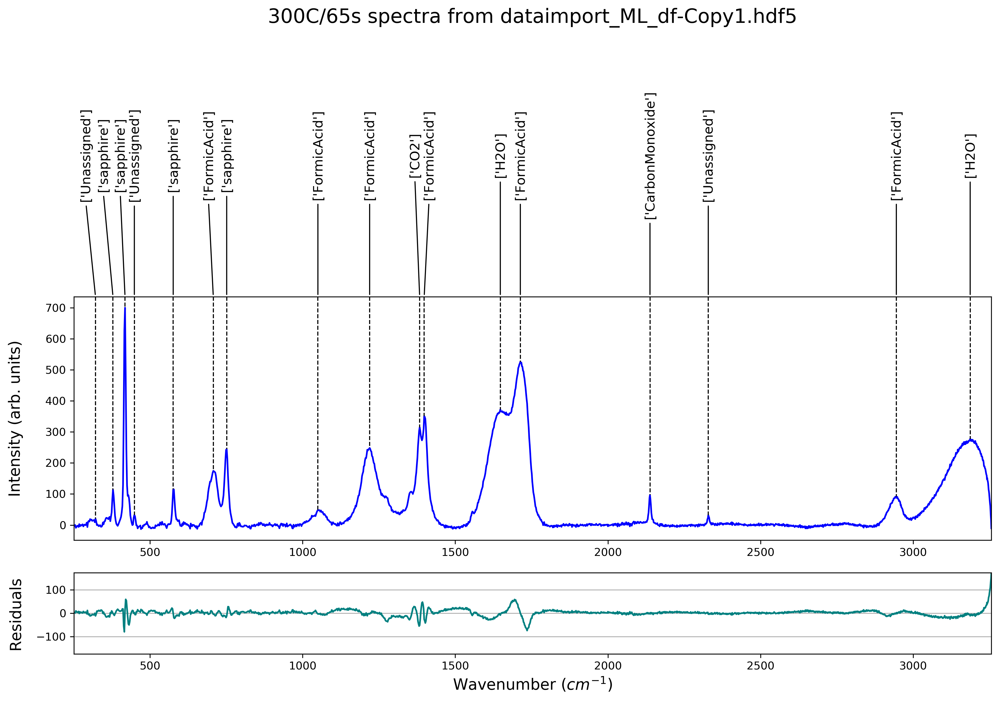

{'CO2': 50.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 100.0, 'Hydrogen': 0.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


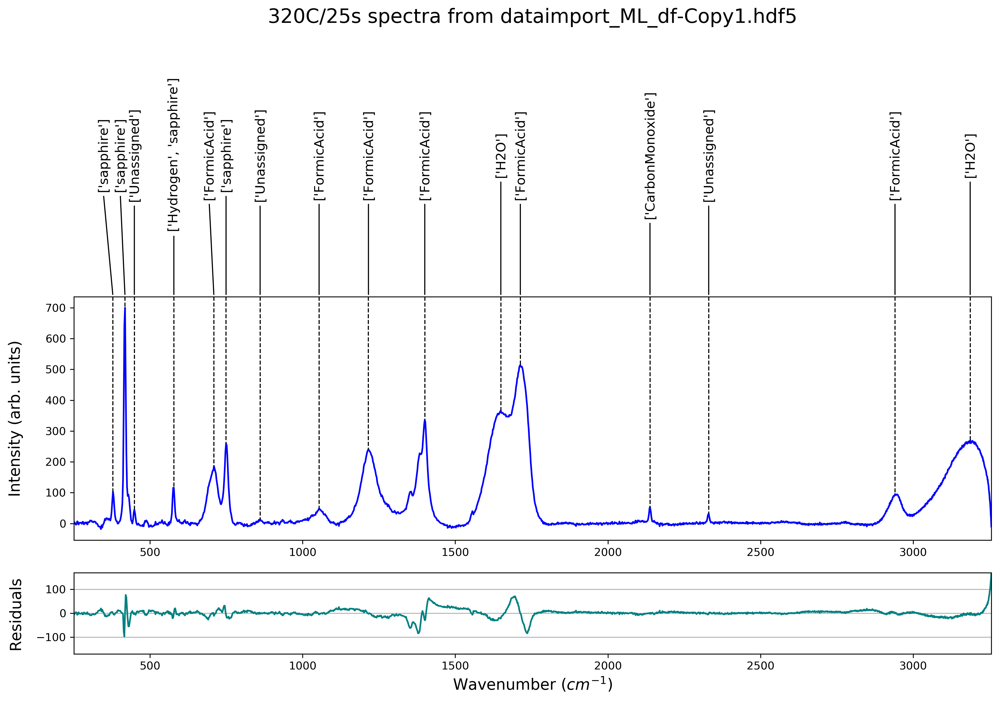

{'CO2': 0.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 100.0, 'Hydrogen': 25.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


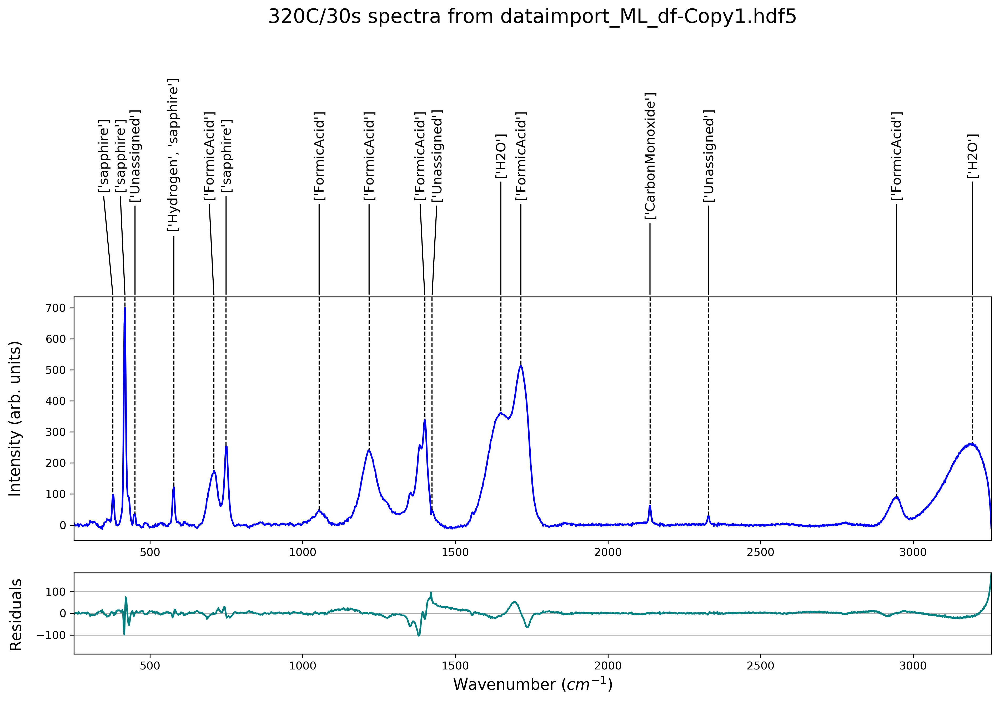

{'CO2': 0.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 100.0, 'Hydrogen': 25.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


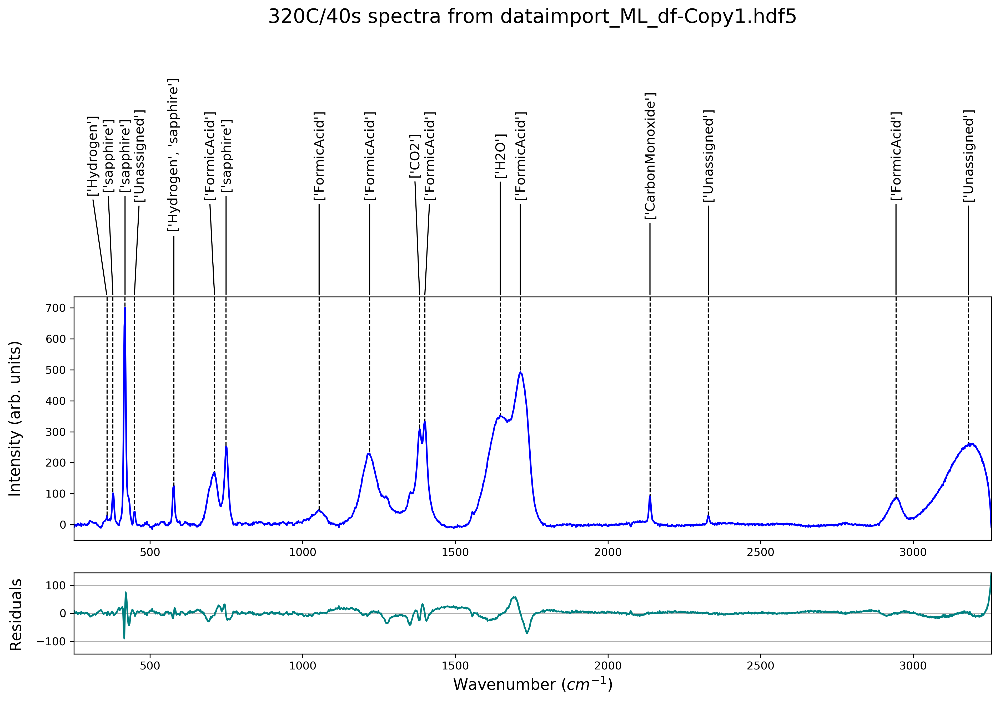

{'CO2': 50.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 50.0, 'Hydrogen': 50.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


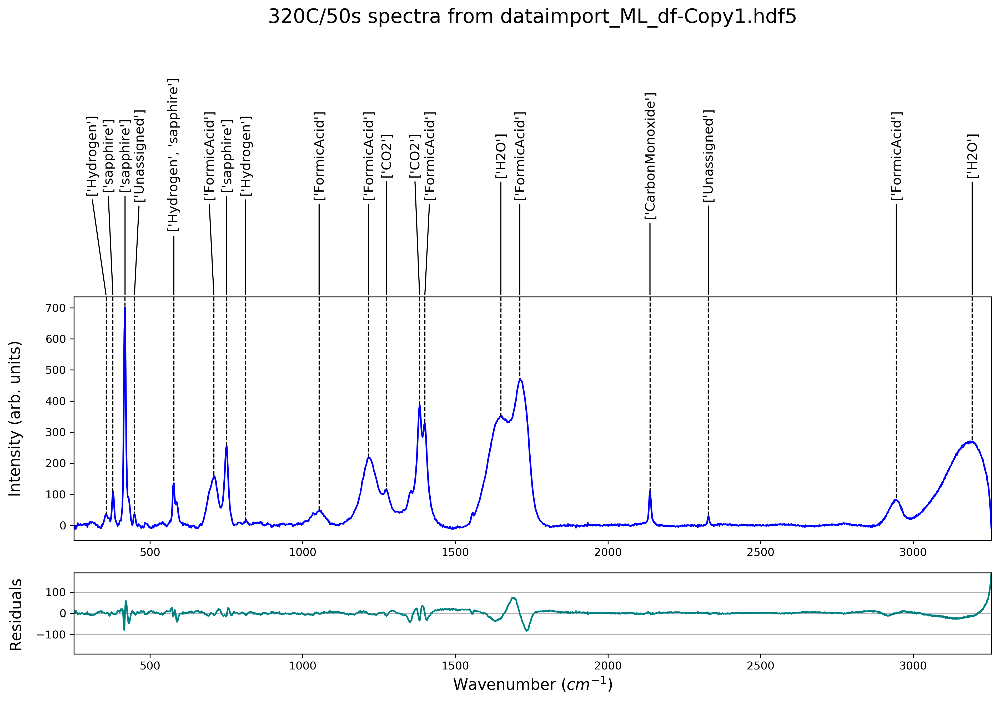

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 100.0, 'Hydrogen': 75.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


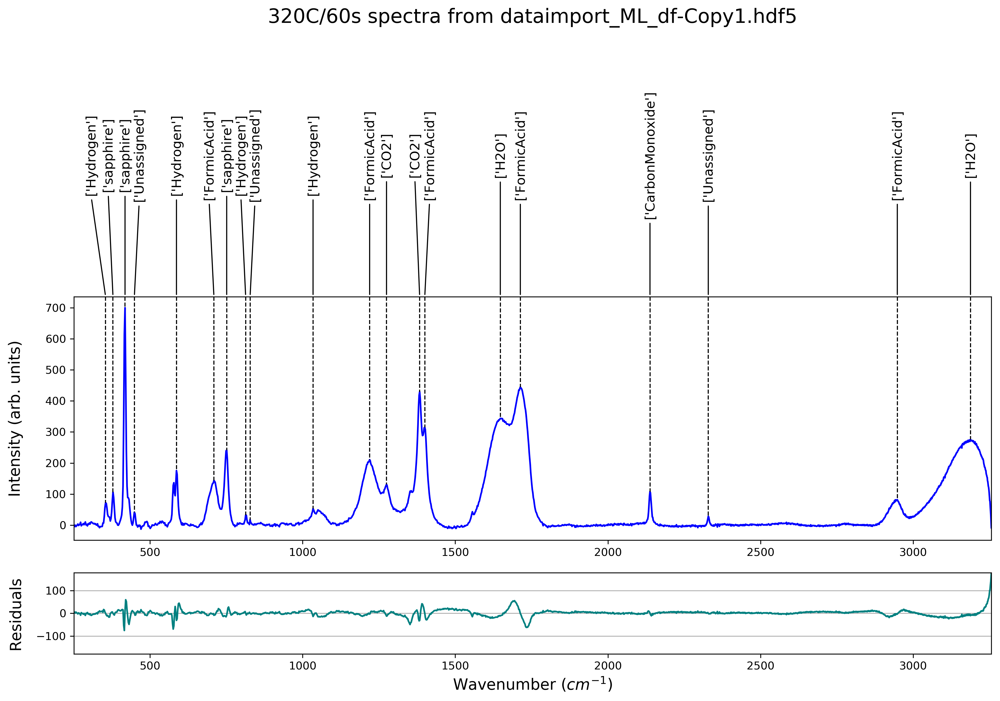

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 83.33333333333334, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


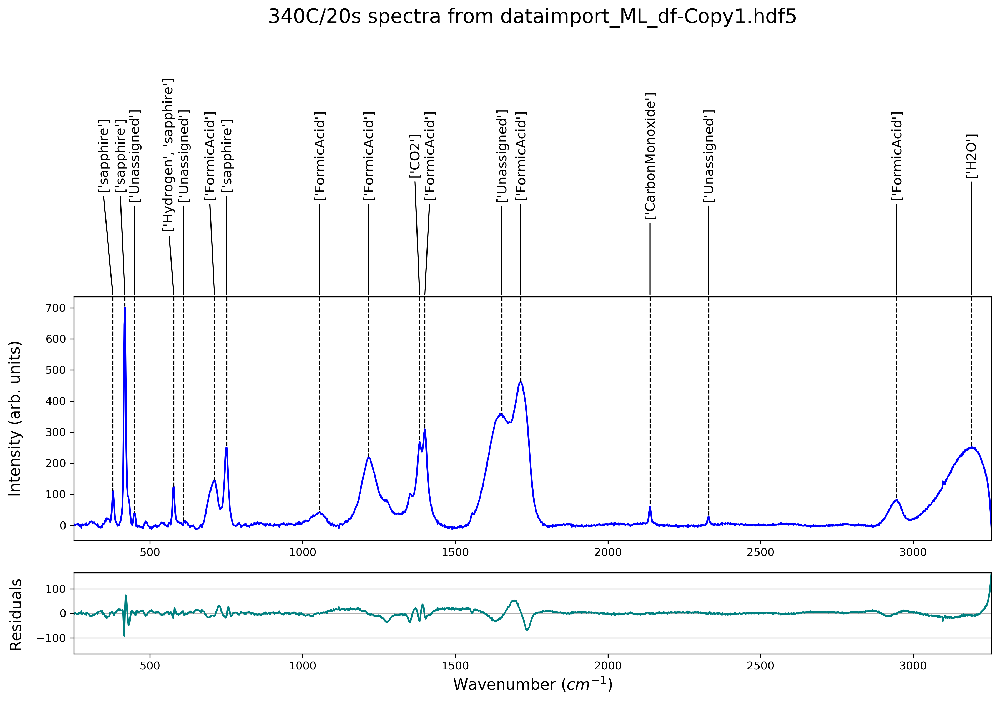

{'CO2': 50.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 50.0, 'Hydrogen': 25.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


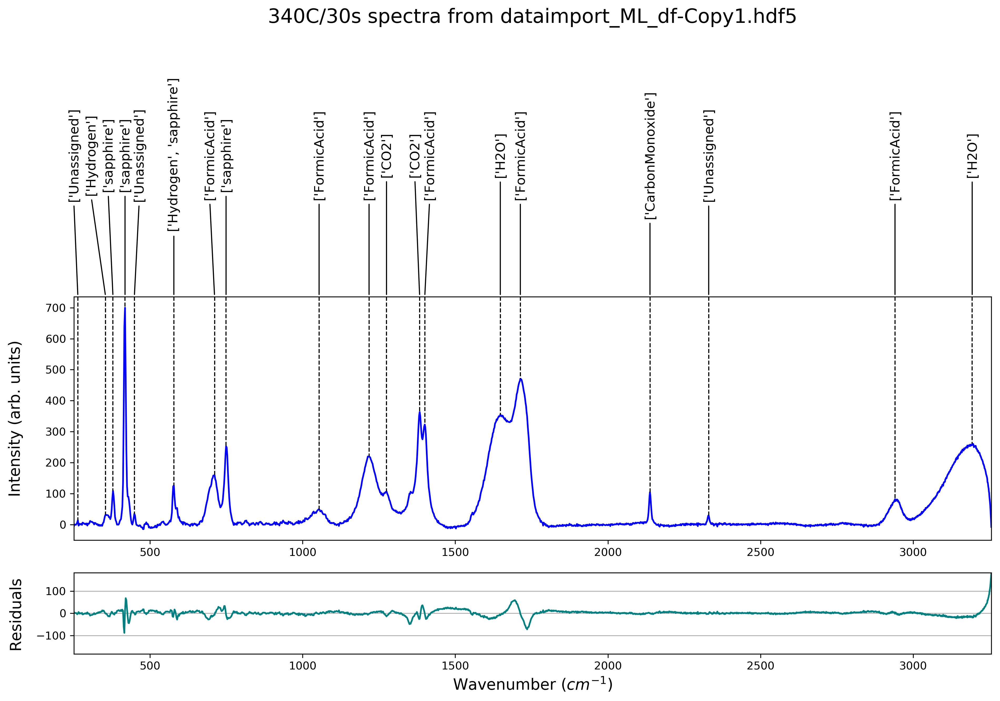

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 100.0, 'Hydrogen': 50.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


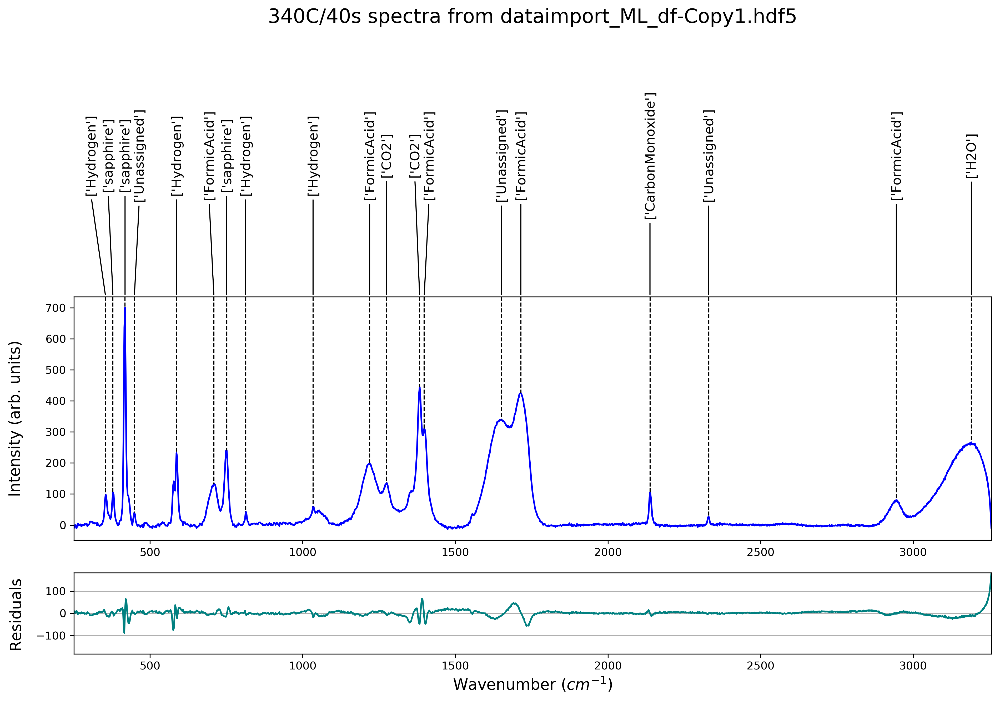

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 83.33333333333334, 'H2O': 50.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


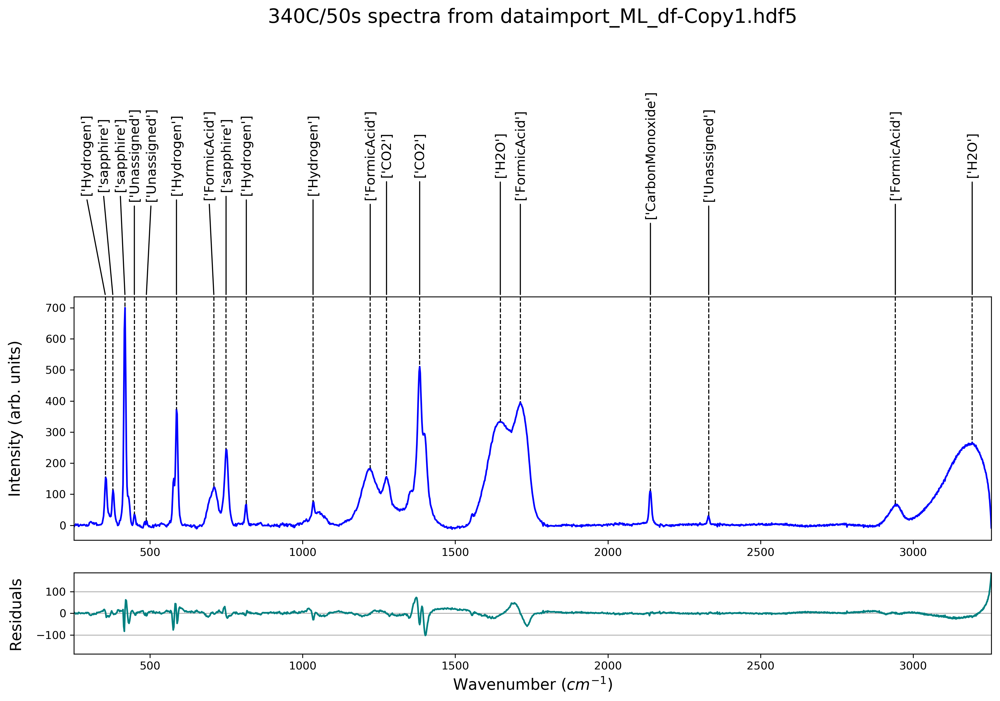

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 66.66666666666666, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


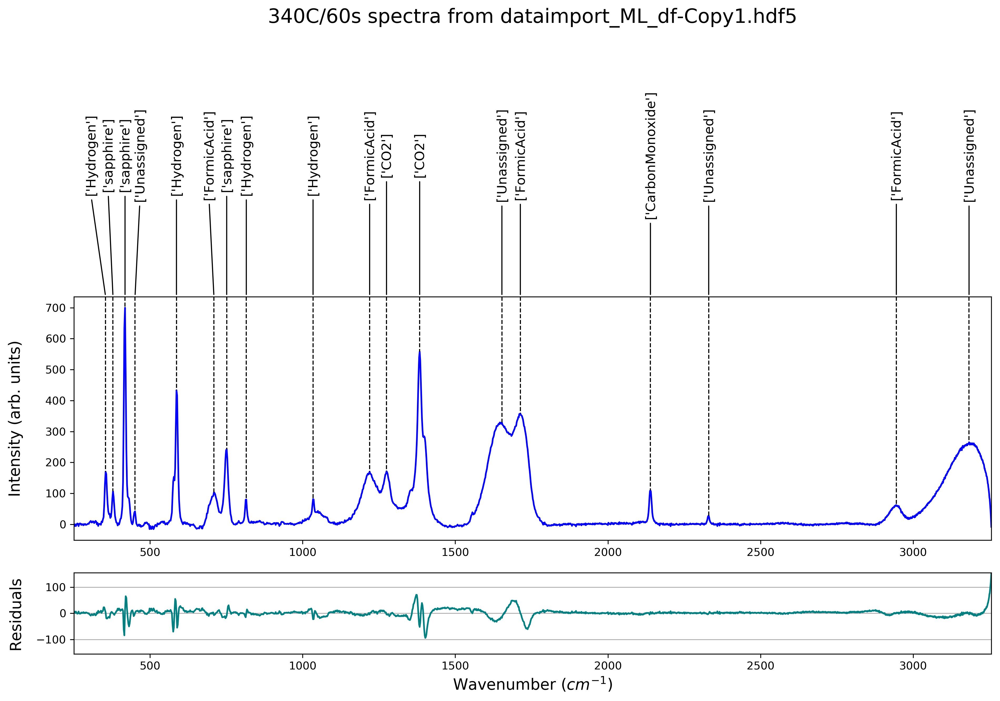

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 66.66666666666666, 'H2O': 0.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


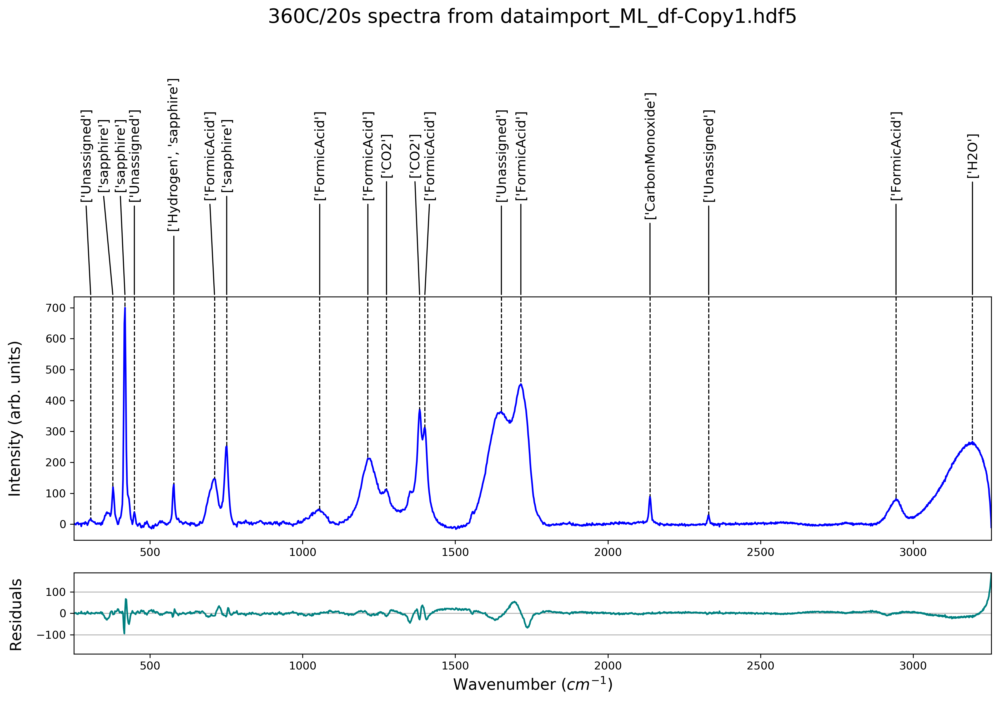

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 100.0, 'H2O': 50.0, 'Hydrogen': 25.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


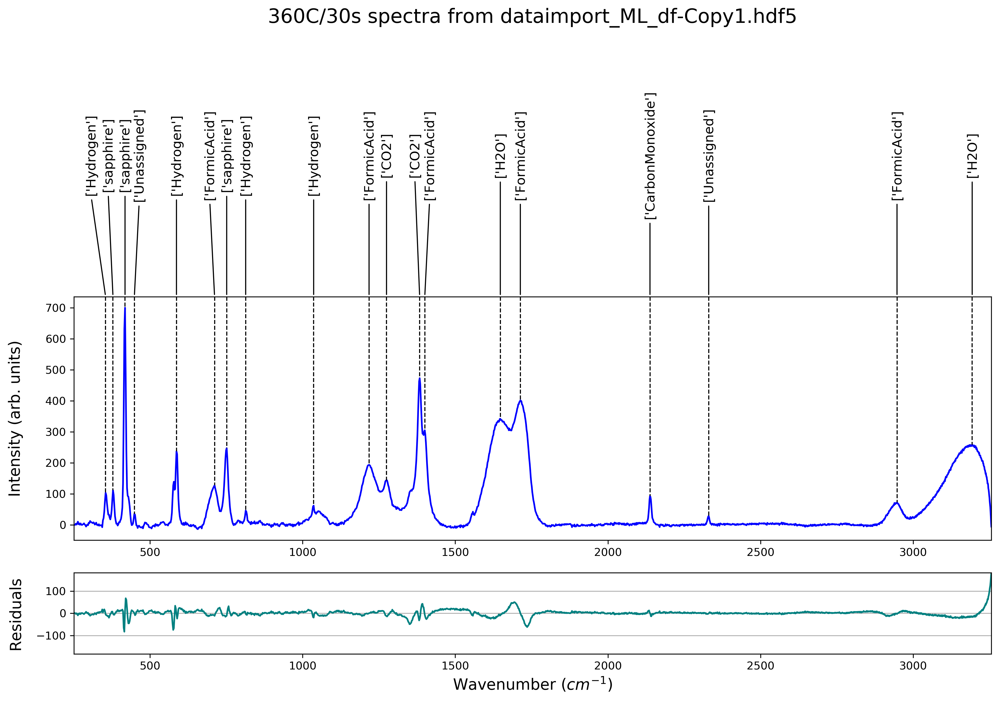

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 83.33333333333334, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


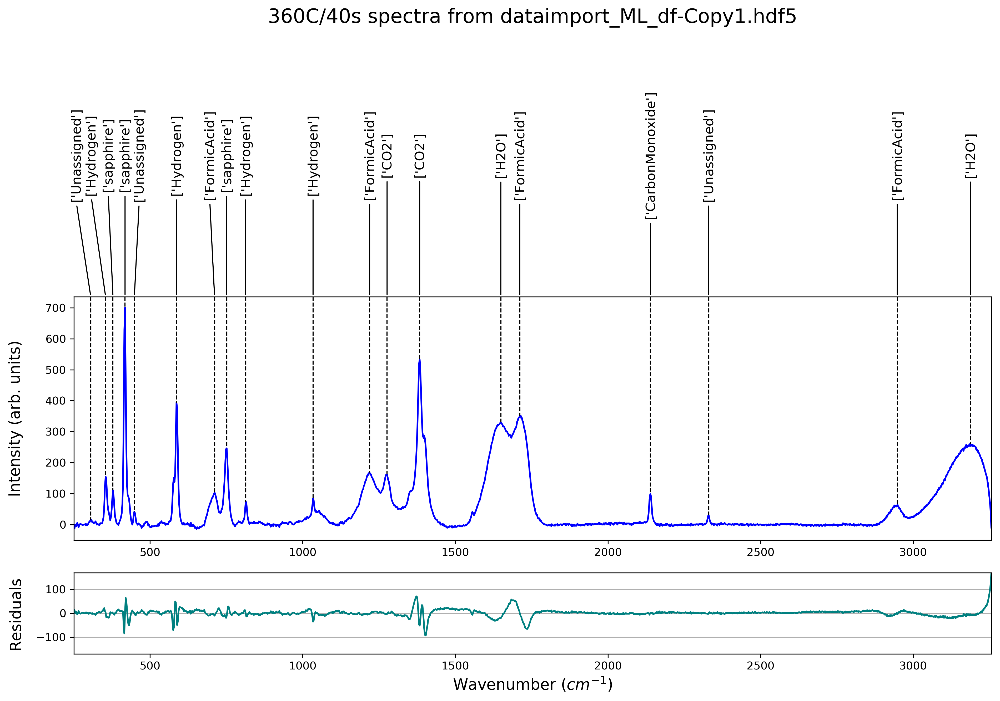

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 66.66666666666666, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


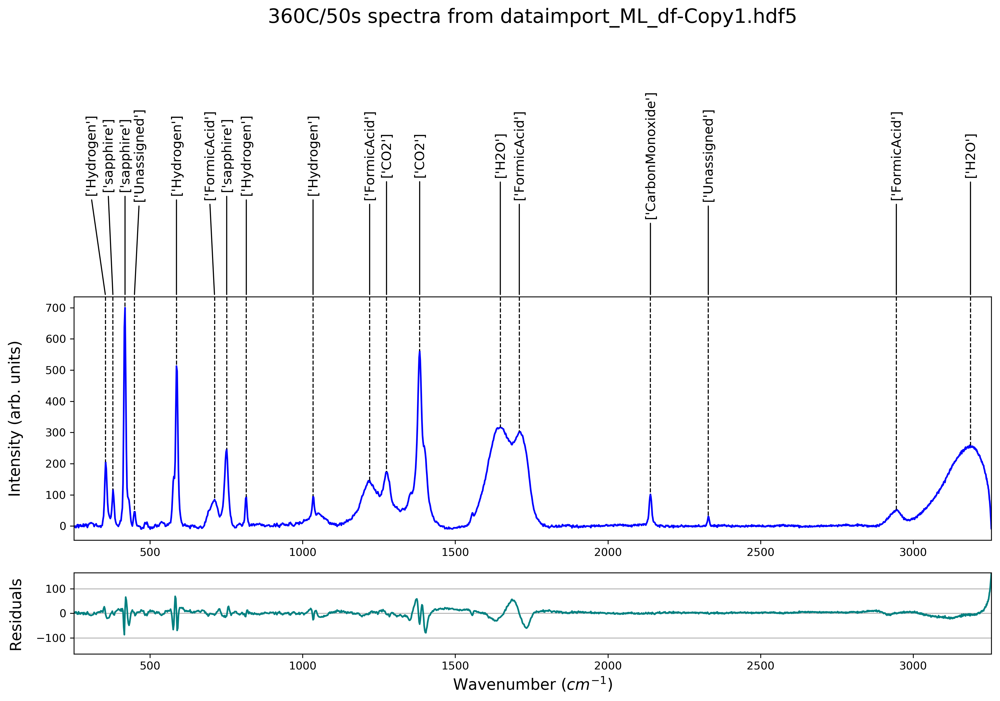

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 66.66666666666666, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


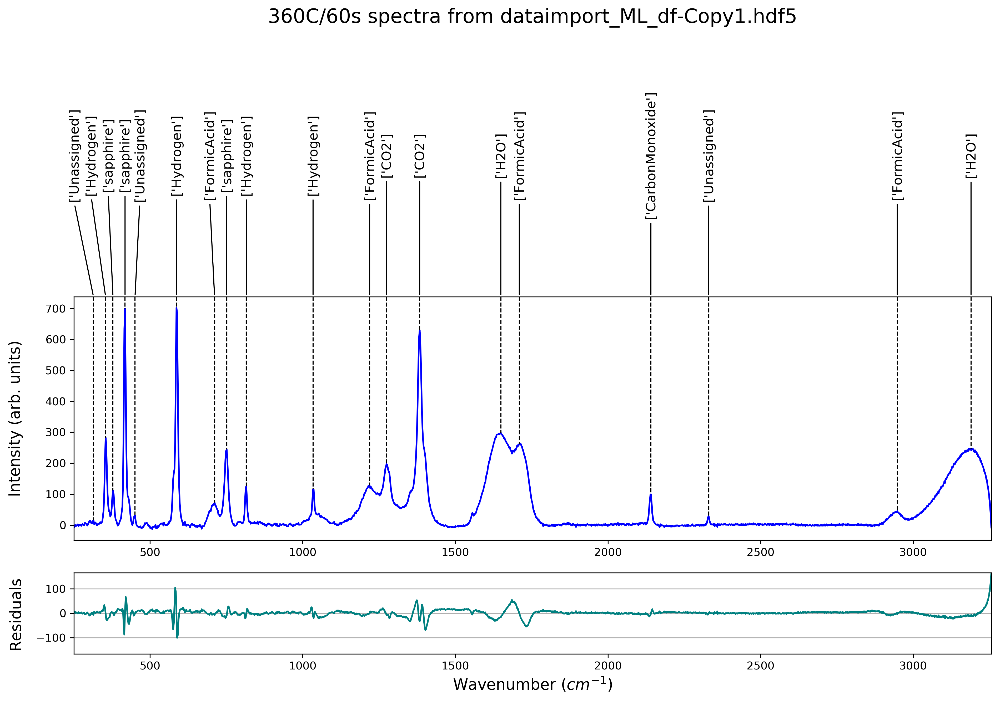

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 66.66666666666666, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


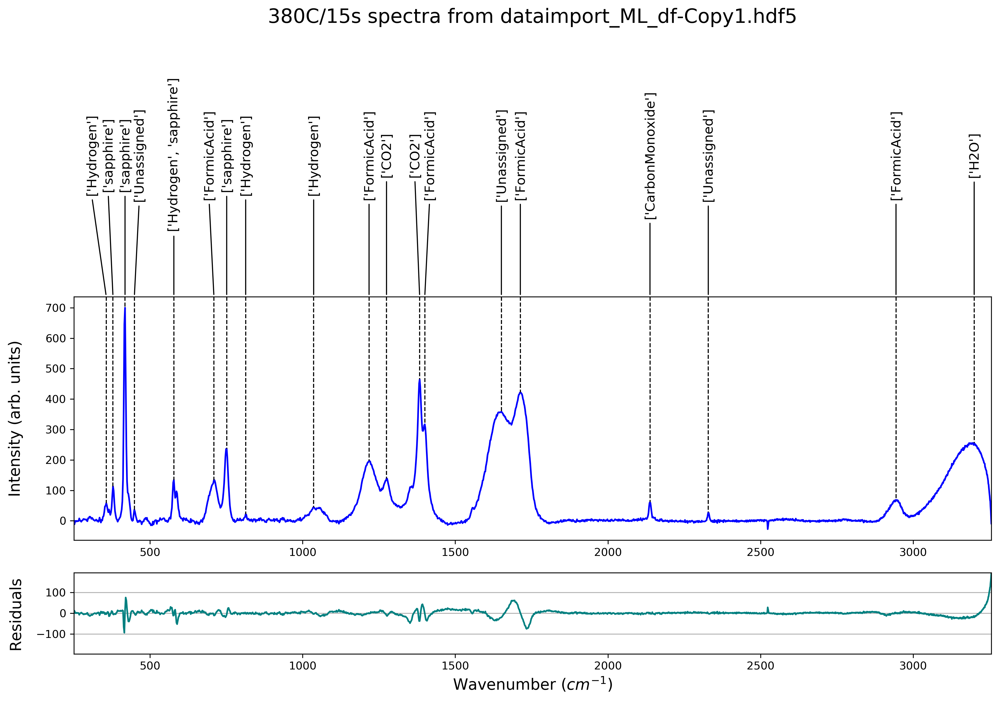

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 83.33333333333334, 'H2O': 50.0, 'Hydrogen': 100.0, 'sapphire': 100.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


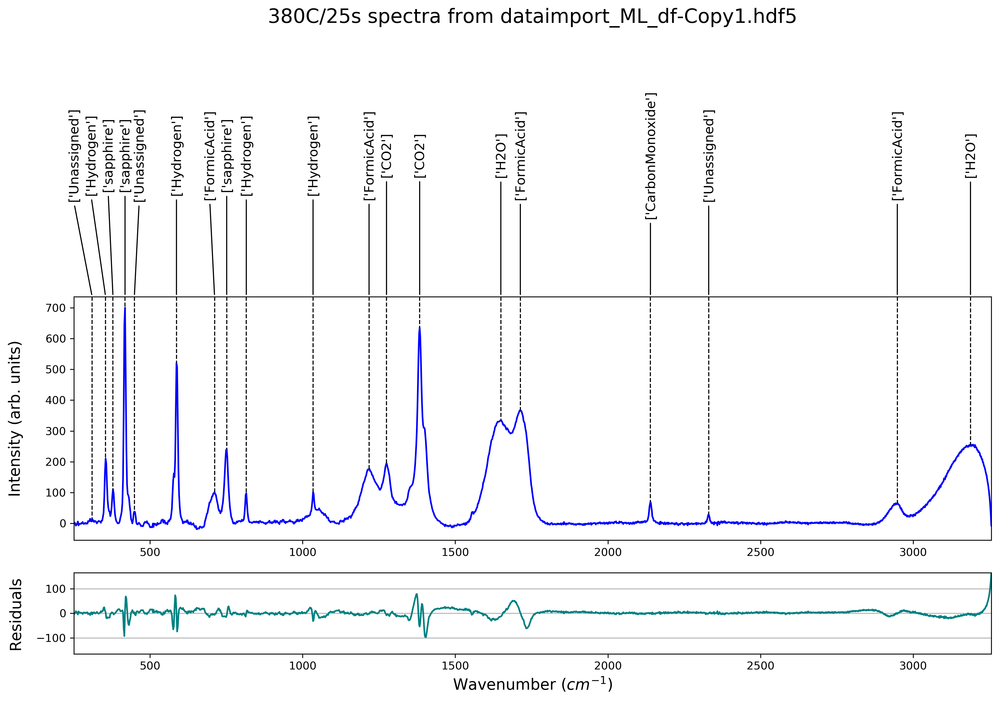

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 66.66666666666666, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


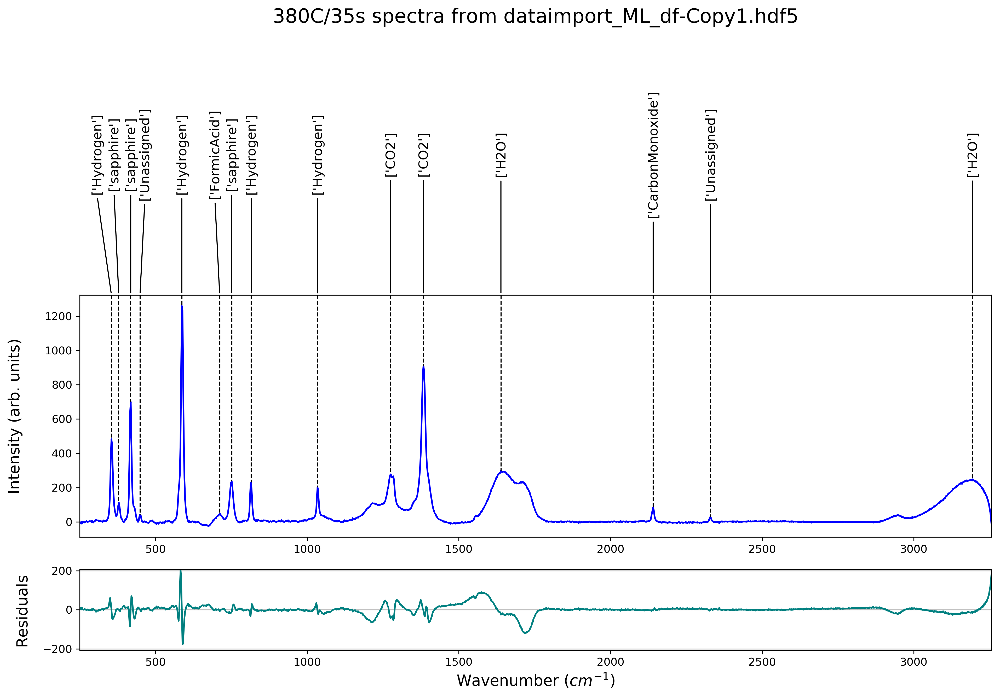

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 16.666666666666664, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


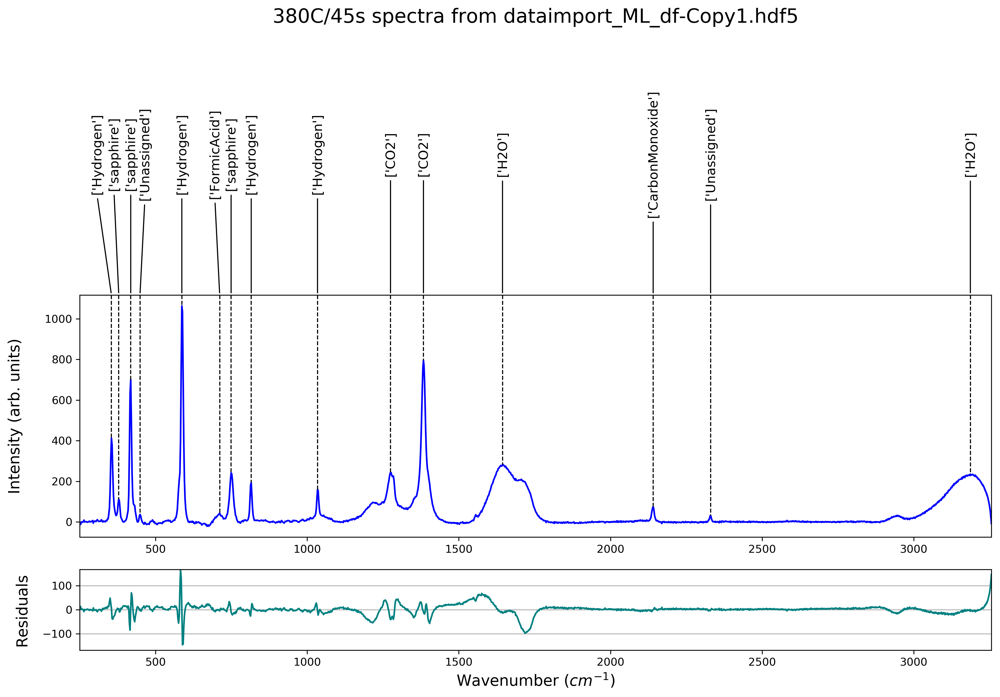

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 16.666666666666664, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


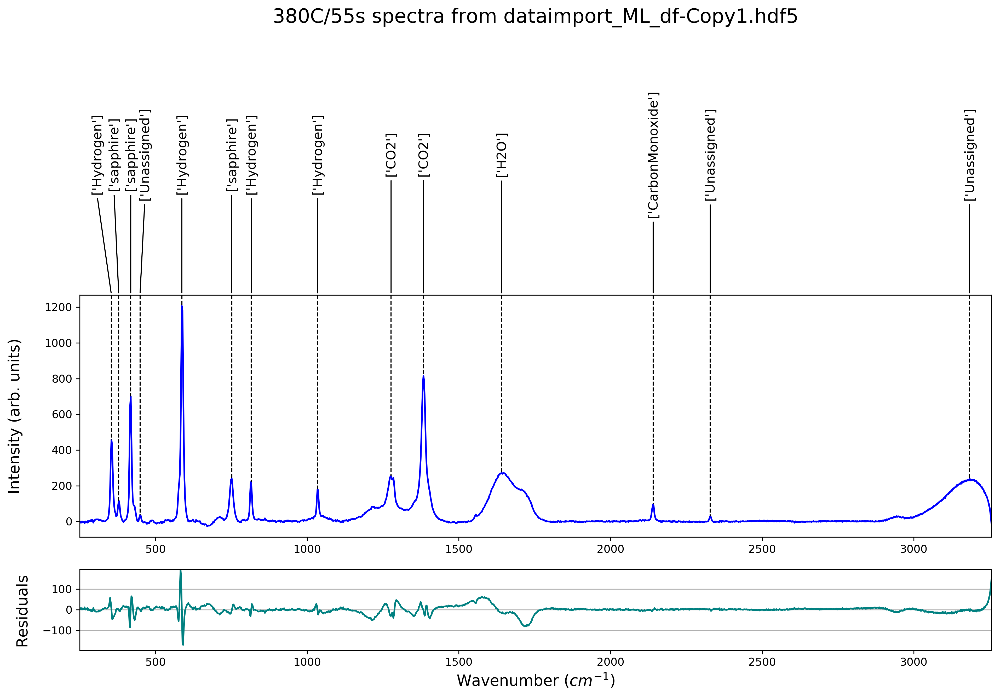

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 50.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


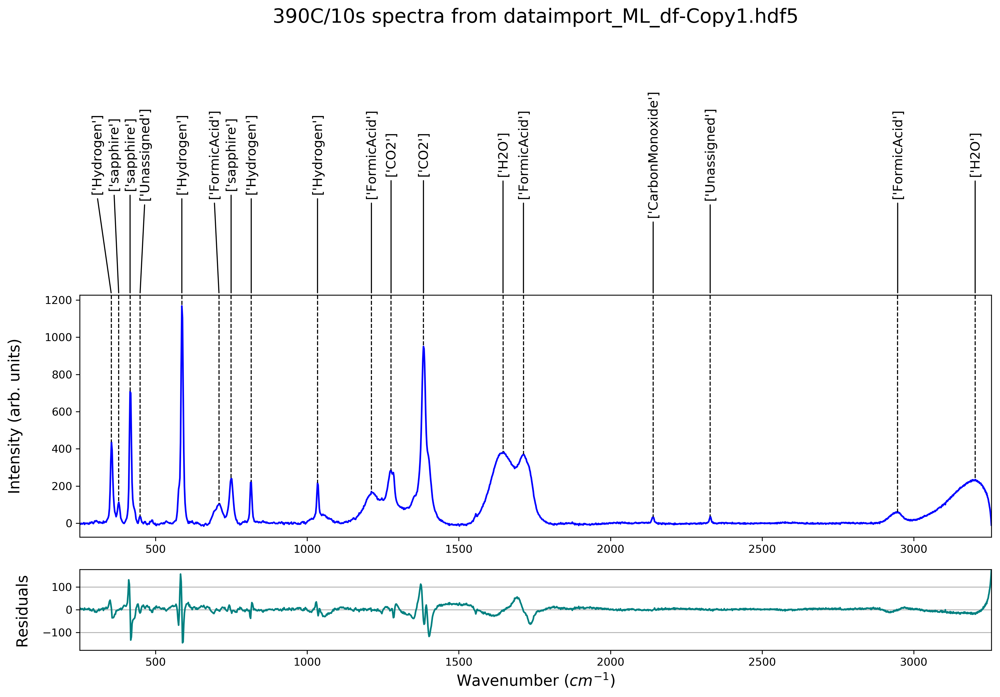

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 66.66666666666666, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


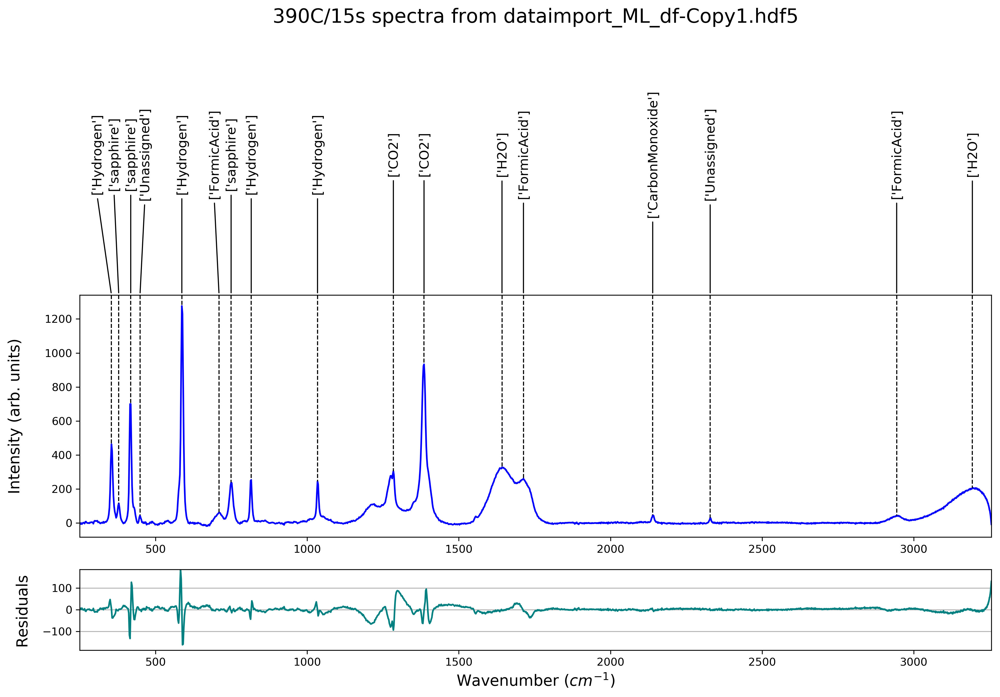

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 50.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


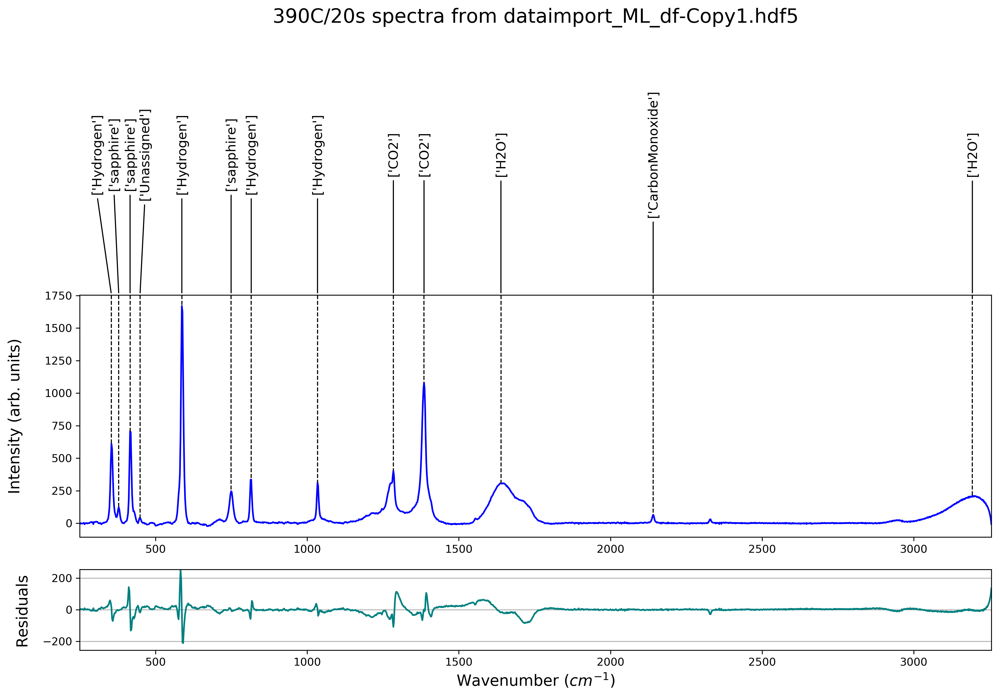

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


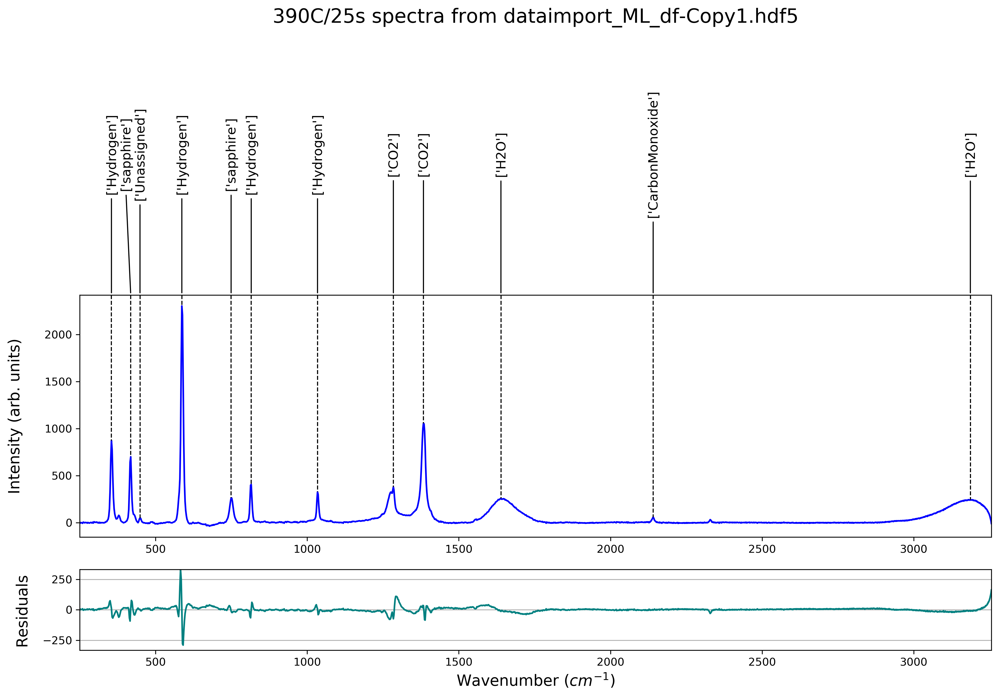

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 50.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


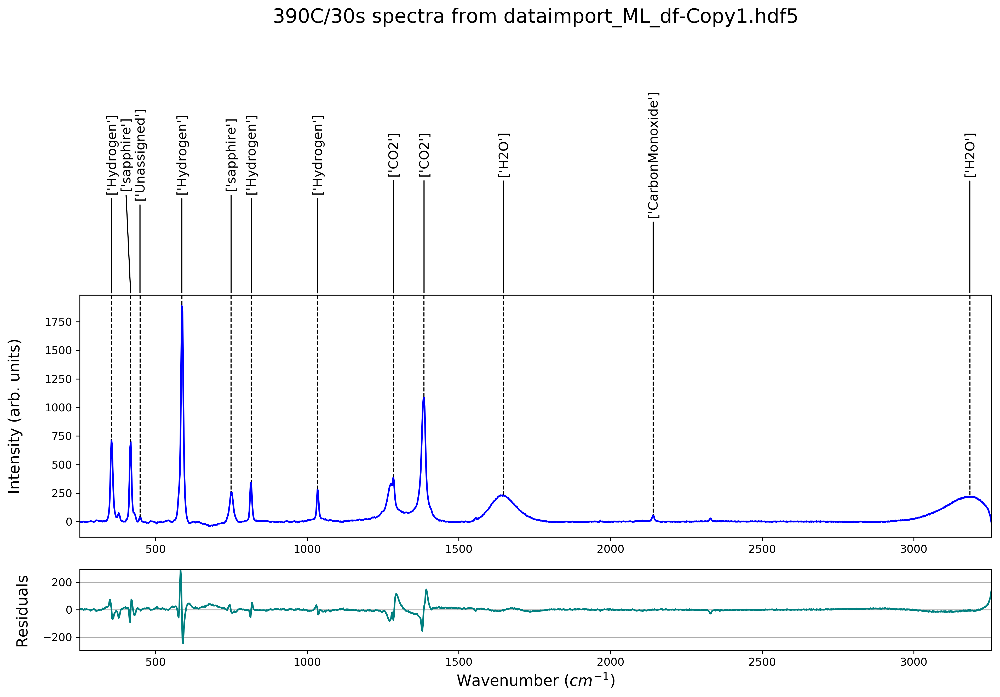

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 50.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


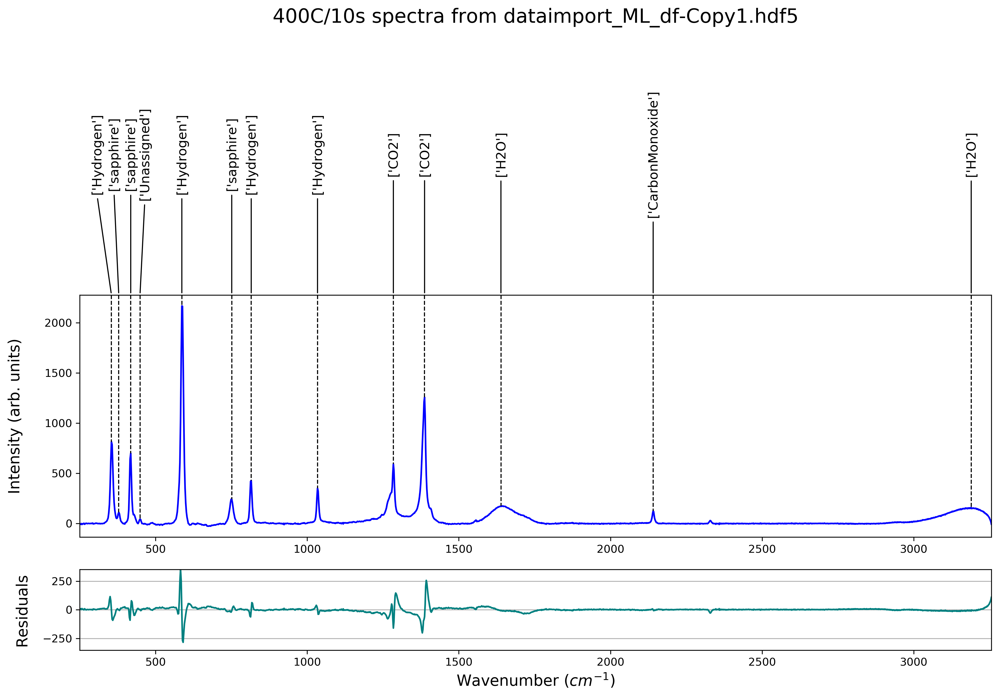

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


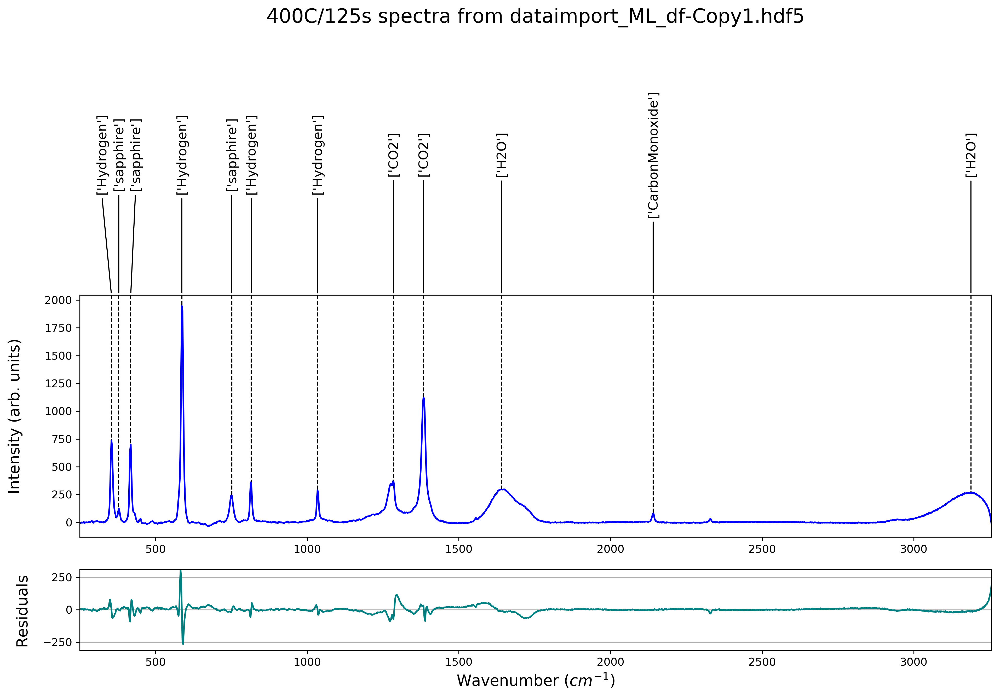

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


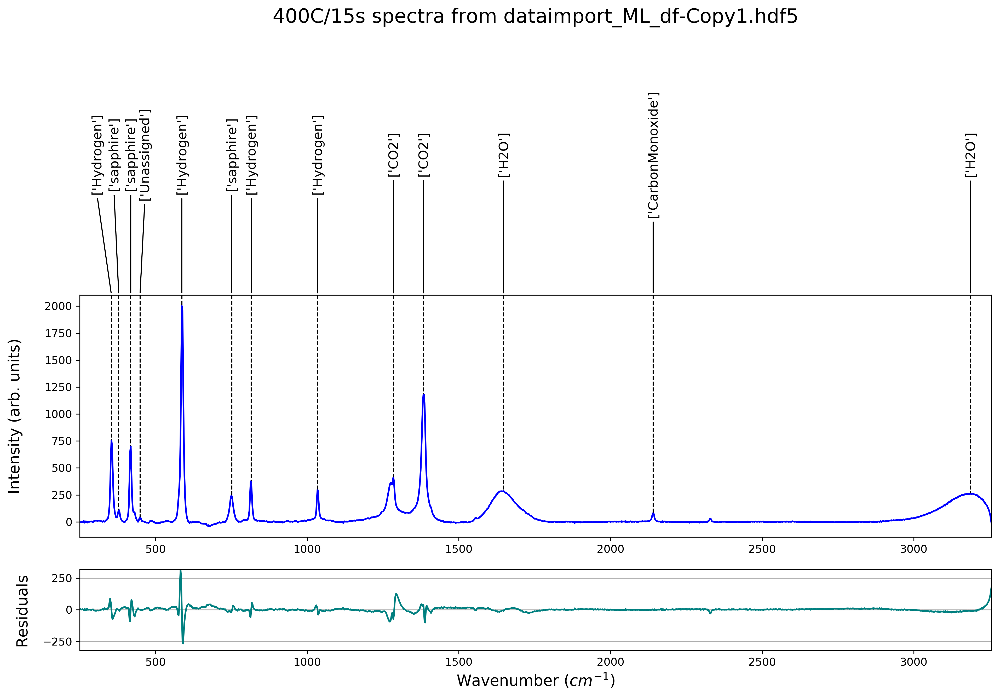

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


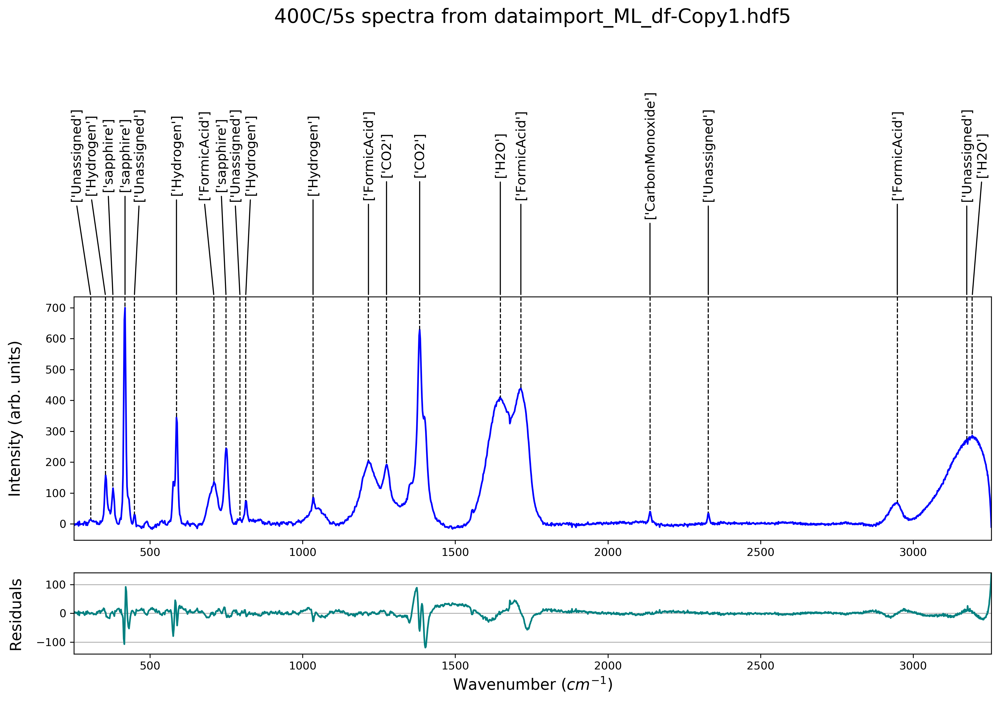

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 66.66666666666666, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


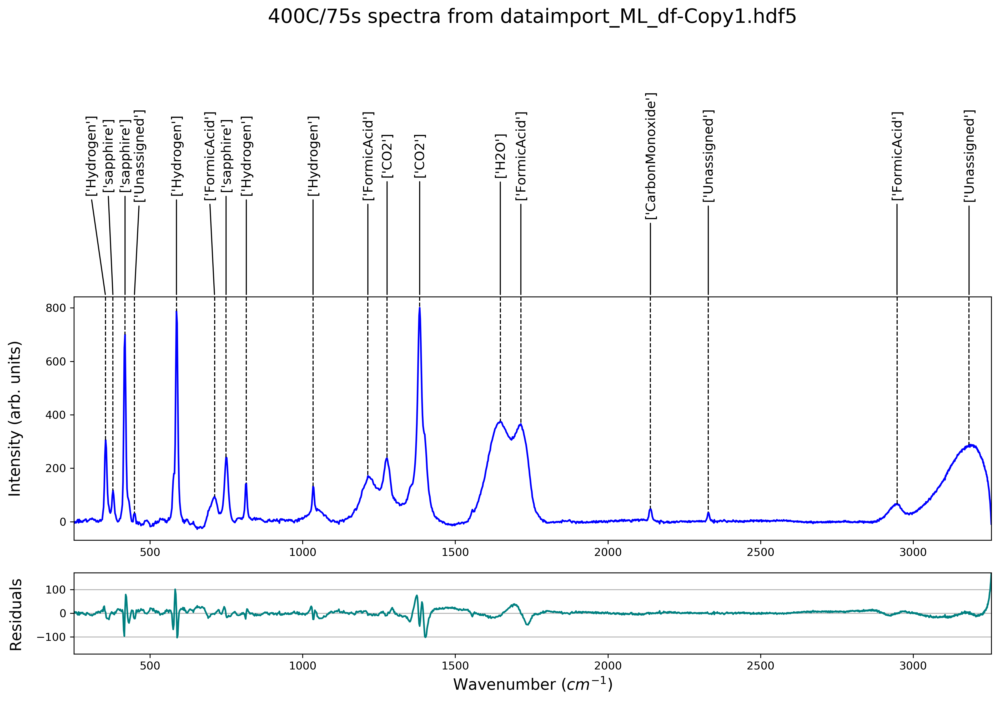

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 66.66666666666666, 'H2O': 50.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


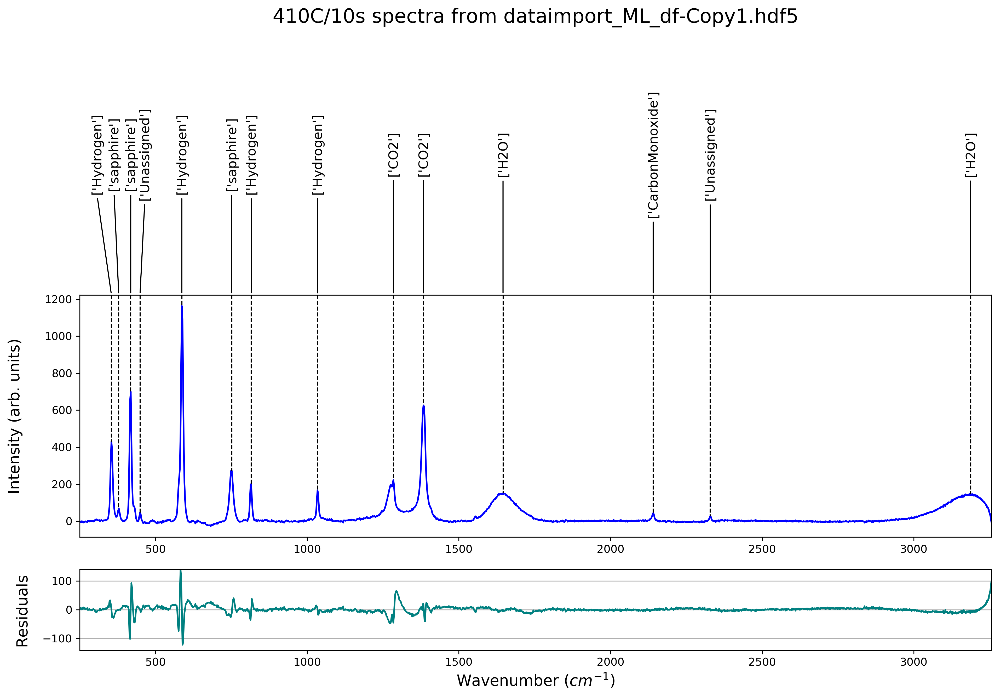

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


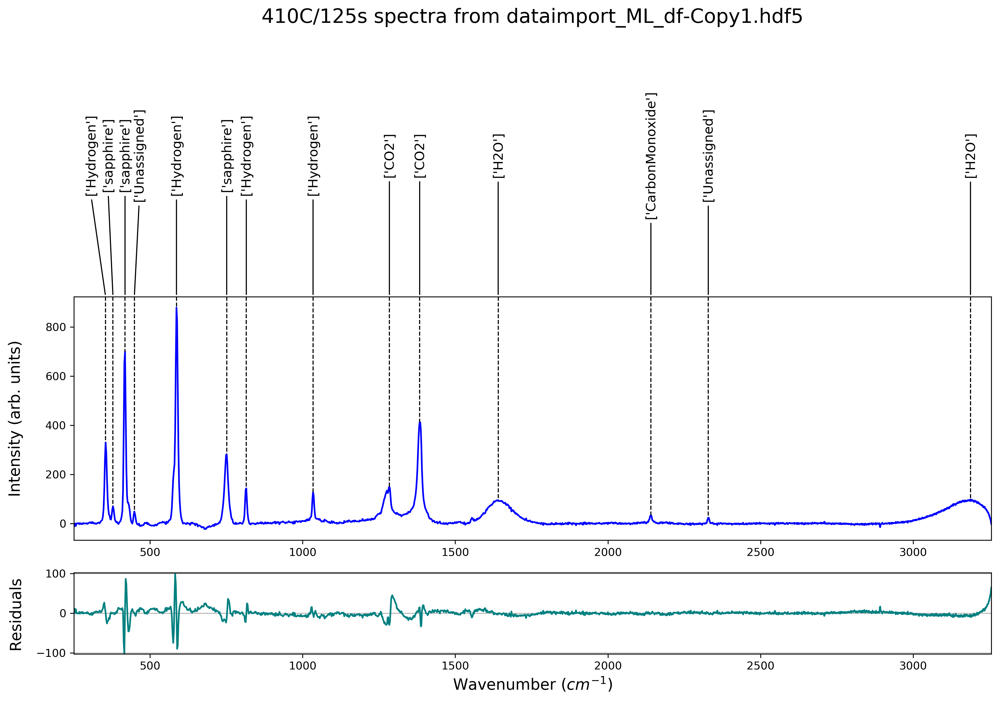

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


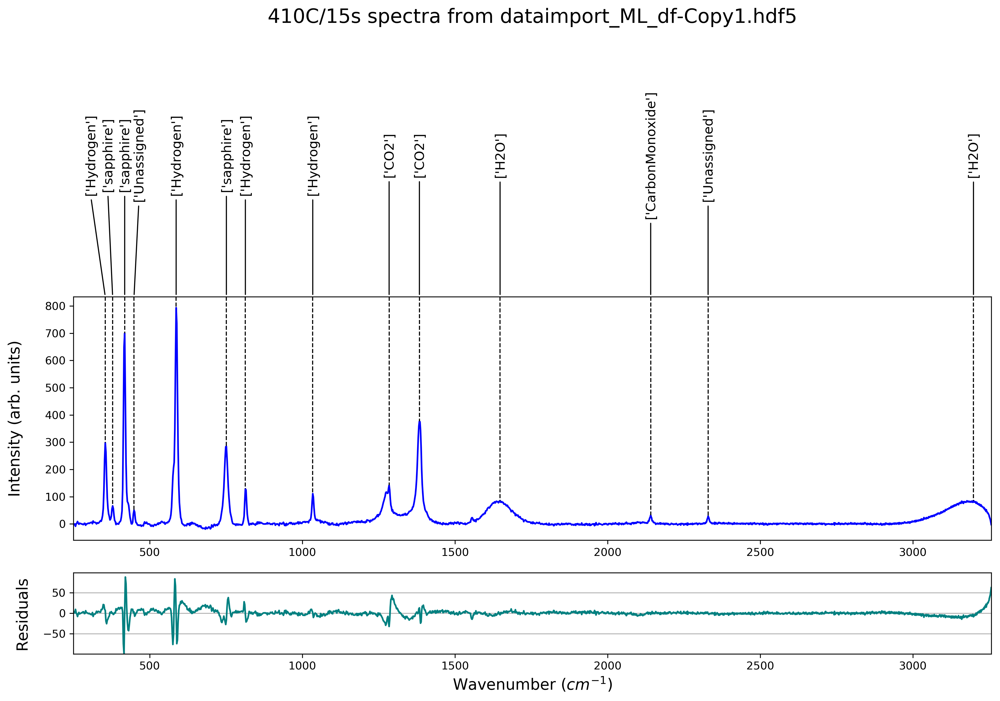

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


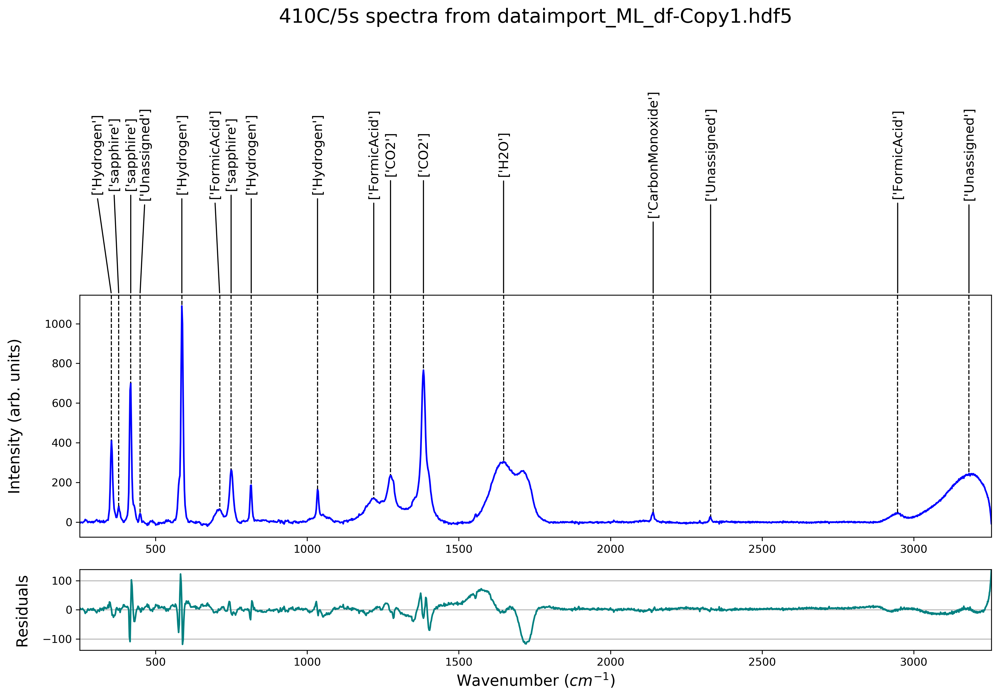

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 50.0, 'H2O': 50.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


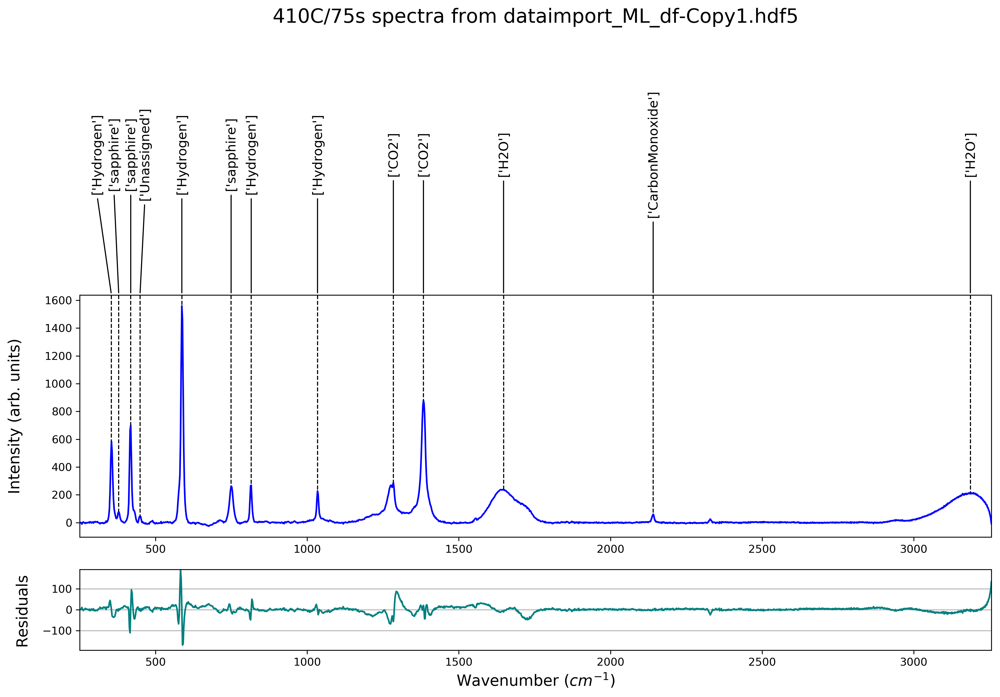

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


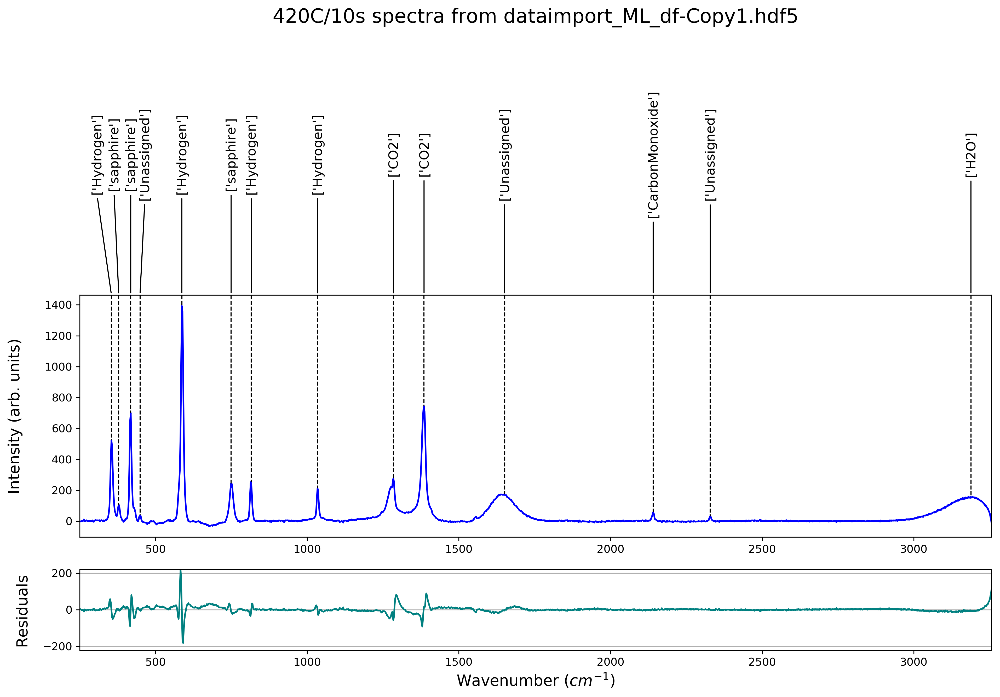

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 50.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


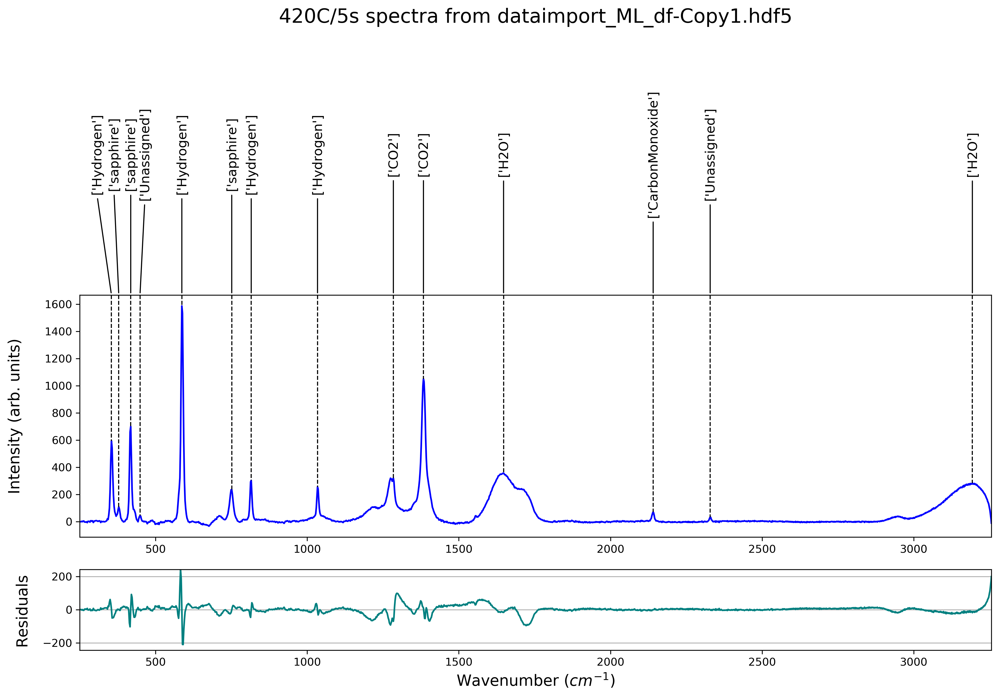

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


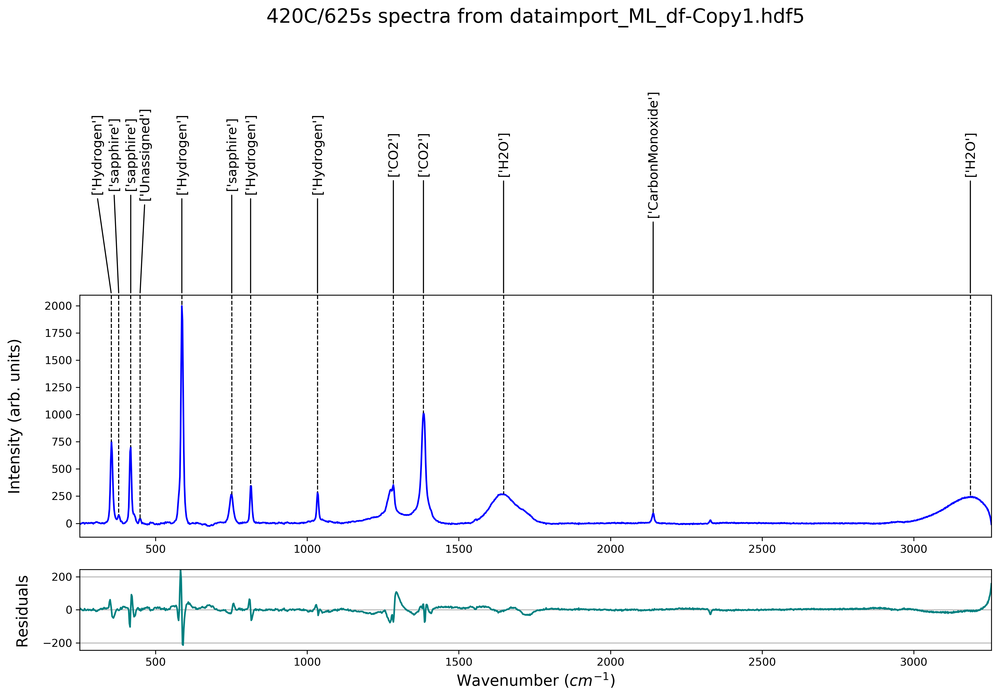

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


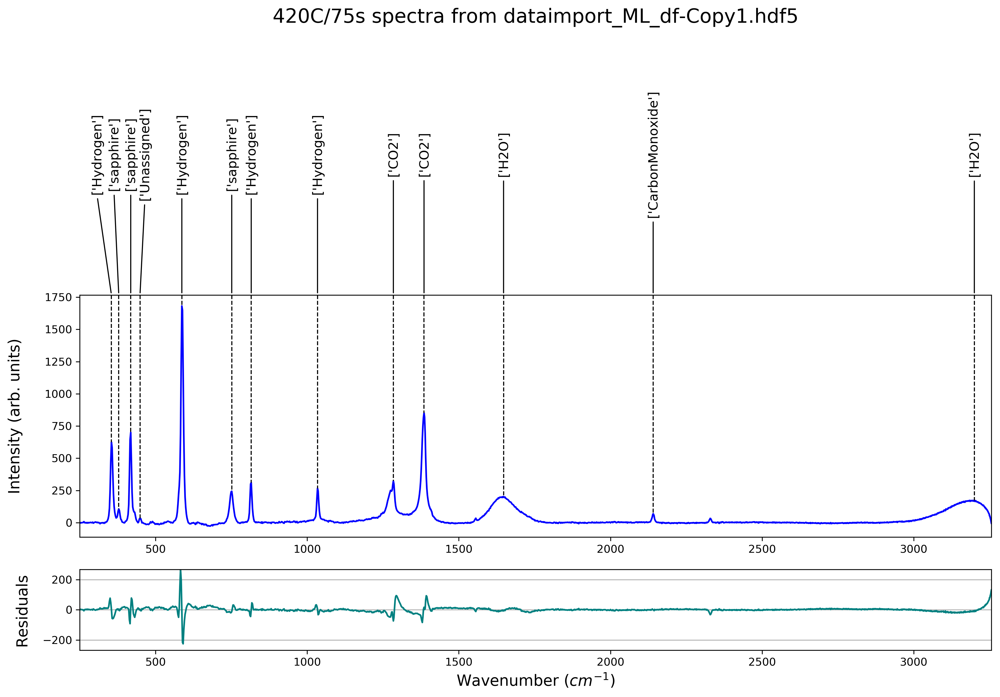

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


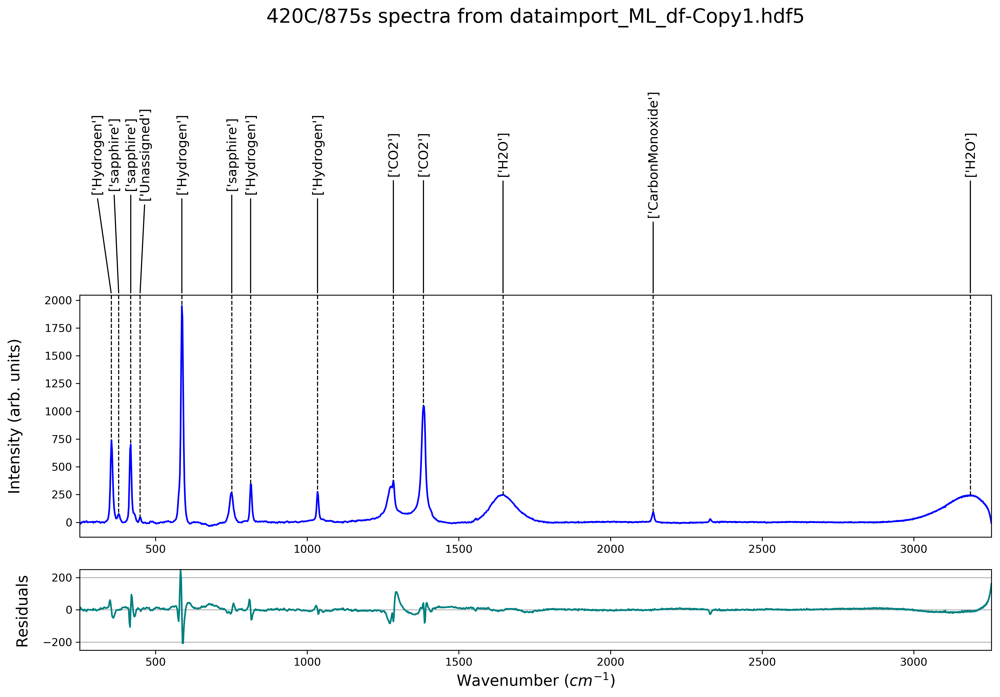

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


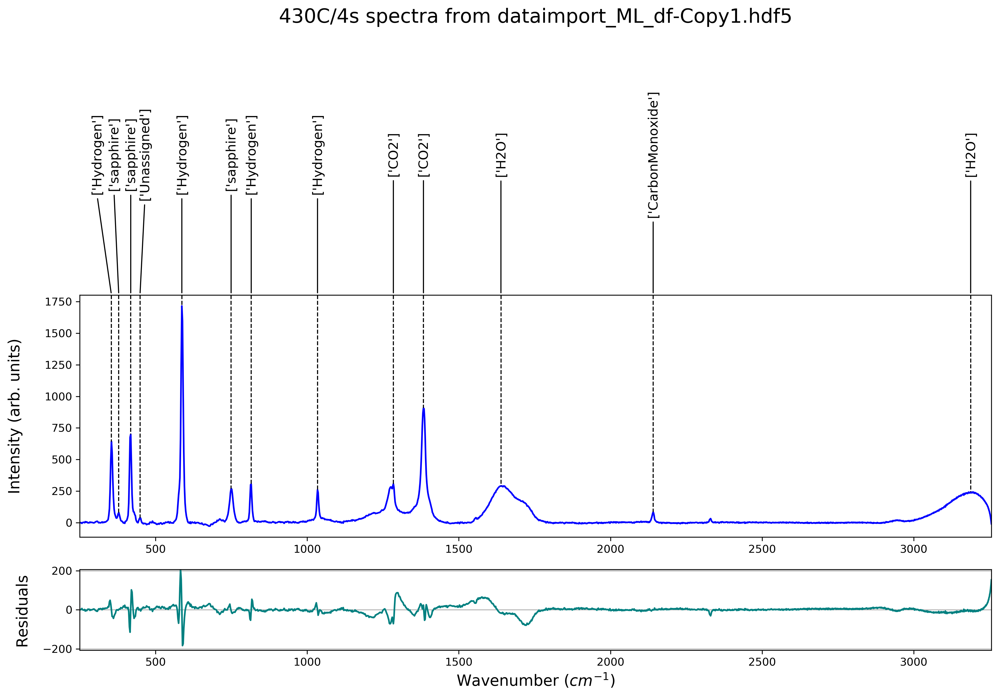

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


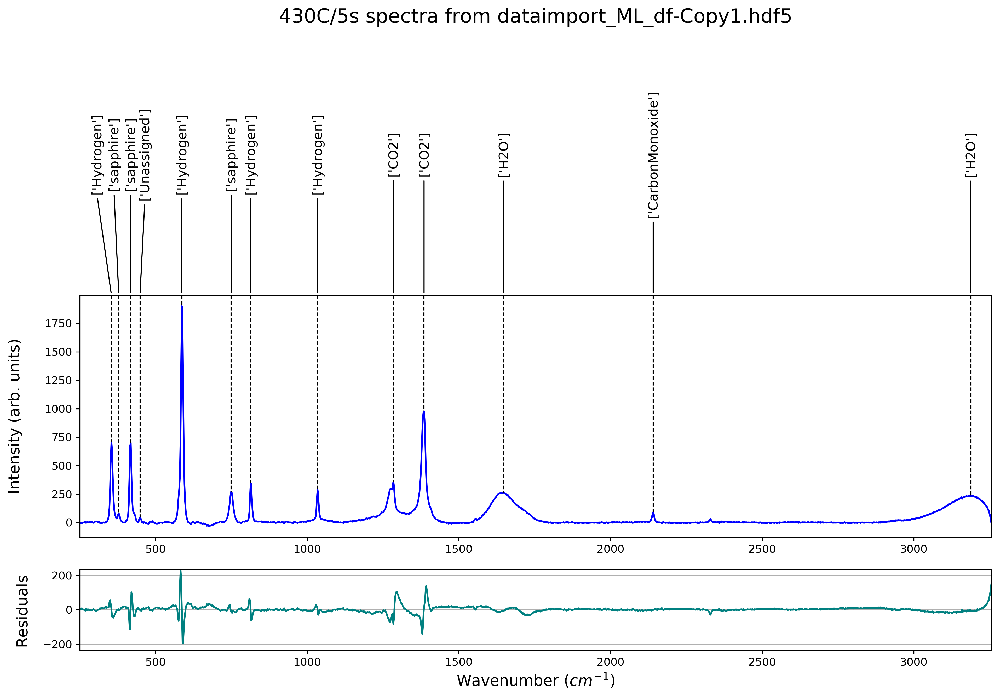

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


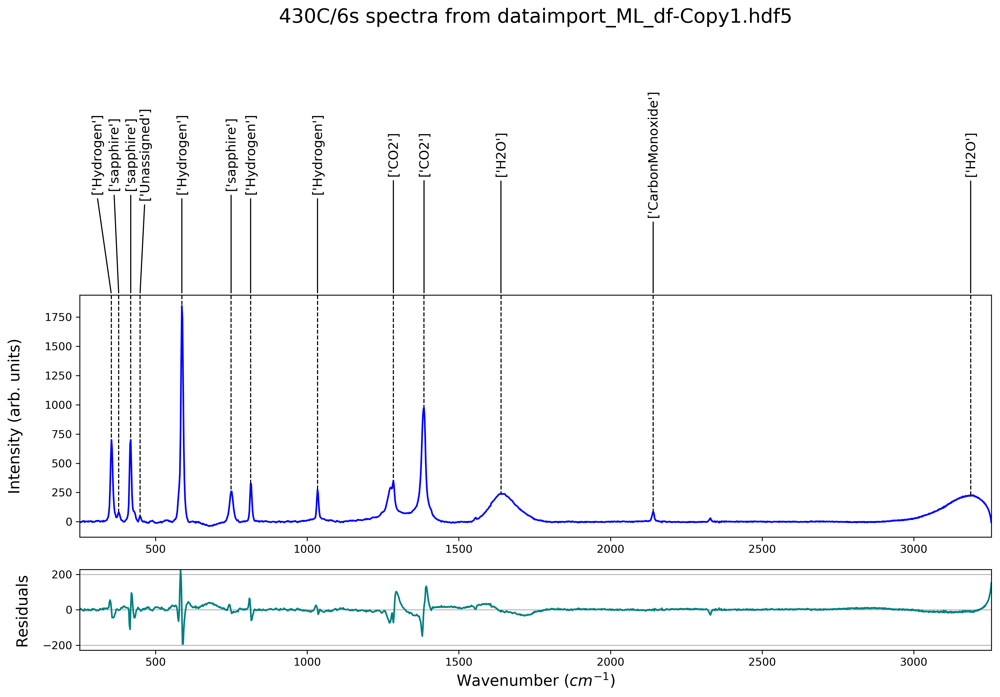

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


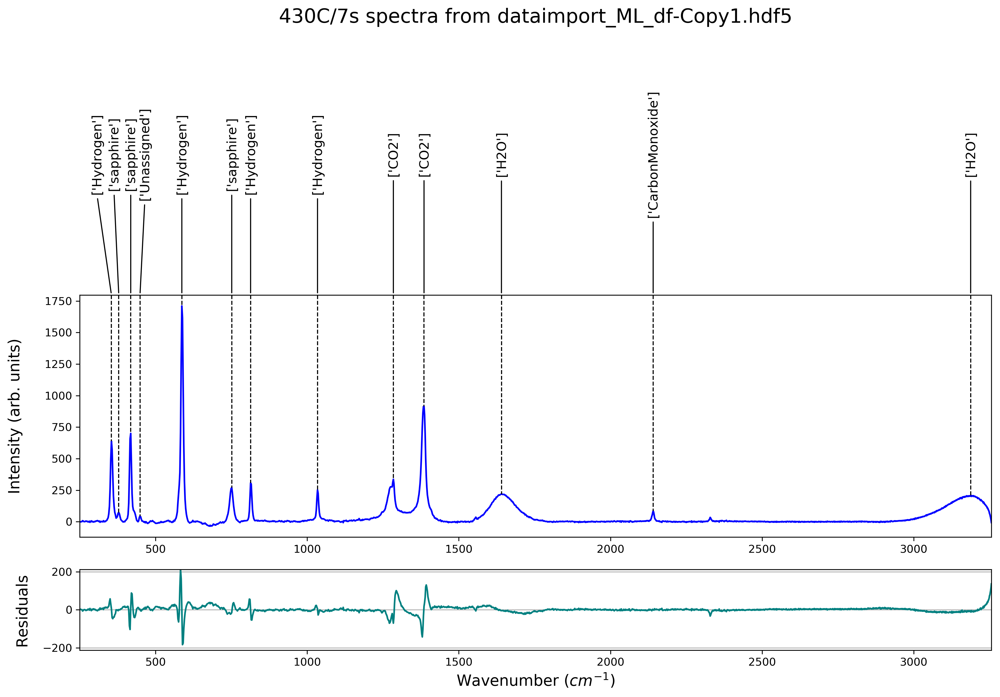

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 100.0, 'Hydrogen': 100.0, 'sapphire': 75.0}
The peaks that we found for CO2 are: 
1280.4
1385.3
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.]
The peaks that we found for CarbonMonoxide are: 
2139.9096496496495
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
The peaks that we found for FormicAcid are: 
707.31
1055.9
1219.5
1400.1
1716.7
2940.6
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
The peaks that we found for H2O are: 
1640.6
3194.4
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
The peaks that we found for Hydrogen are: 
355.6504104104104
587.3333133133133
816.0073473473473
1035.6547747747748
[1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.]
The peaks that we found for sapphire are: 
378.71
418.14
575.97
751.21
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
export labelling only


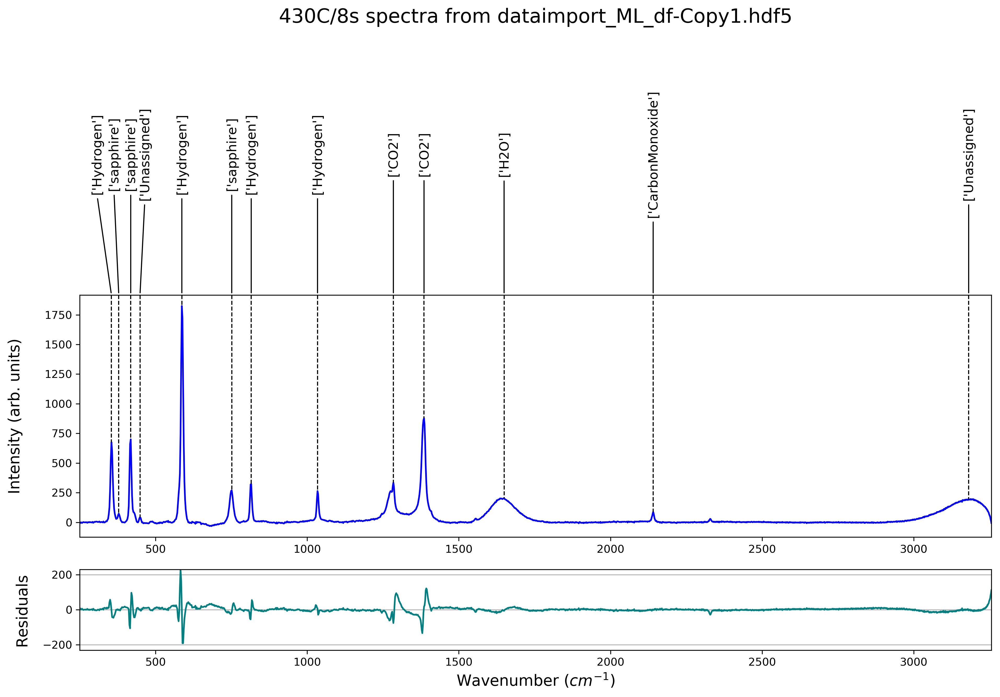

{'CO2': 100.0, 'CarbonMonoxide': 100.0, 'FormicAcid': 0.0, 'H2O': 50.0, 'Hydrogen': 100.0, 'sapphire': 75.0}


In [21]:
#making a loop to identify peaks in all experimental data set and add label to them
frames = []
for i, key in enumerate(exp_key_list):
    df = peakidentify.peak_assignment(hdf5_expfilename, key, hdf5_calfilename, 10)
    frames.append(df)


In [22]:
#making sure the value is stored as a list
type(frames)

list

# Step 5: Calculate Molar Decomposition

To define the molar decomposition the area of the experimental data will be divided by the calibration data's area. This value will be the molar amount of the substance at the given experimental temperature and resonance time.

## Step 5.1 Collect Needed Experimental Data Into Data Frame

In [38]:
result = pd.concat(frames,axis=0, join='outer', join_axes=None, ignore_index=False,
         keys=exp_key_list, levels=None, names=None, verify_integrity=False,
         copy=True,sort=True)

dat = pd.DataFrame()

dat['center']= result[:][2]
dat['auc']= result[:][6]
dat['labels']= result[:][7]

#print data frame to see that items were imported correctly
dat

center      auc                    labels
300C/25s 0   314.77  251.852            ['Unassigned']
         1   378.71  1028.59              ['sapphire']
         2   418.14  7270.35              ['sapphire']
         3   448.67  193.741            ['Unassigned']
         4   578.11  1089.49  ['Hydrogen', 'sapphire']
         5   711.51  6837.15            ['FormicAcid']
         6   751.21  3533.44              ['sapphire']
         7   1055.9  1438.24            ['FormicAcid']
         8   1217.6  20534.1            ['FormicAcid']
         9   1400.1  15166.6            ['FormicAcid']
         10  1649.3  35138.2                   ['H2O']
         11  1714.9  25776.7            ['FormicAcid']
         12  2137.9  285.521        ['CarbonMonoxide']
         13  2328.9  255.753            ['Unassigned']
         14  2948.2  3553.09            ['FormicAcid']
         15  3185.1  41554.6                   ['H2O']
300C/35s 0   378.71   980.38              ['sapphire']
         1   418.14  7196.91              ['sapphire']
         2   450.84  150.027            ['Unassigned']
         3   578.11  1226.57  ['Hydrogen', 'sapphire']
         4   614.36  204.764            ['Unassigned']
         5   711.51  7441.88            ['FormicAcid']
         6   751.21   3457.8              ['sapphire']
         7   1055.9  1501.97            ['FormicAcid']
         8   1217.6  21355.3            ['FormicAcid']
         9   1400.1  16168.3            ['FormicAcid']
         10  1651.1  37279.7            ['Unassigned']
         11  1713.2  26140.1            ['FormicAcid']
         12  2137.9  531.501        ['CarbonMonoxide']
         13  2330.3  209.423            ['Unassigned']
...             ...      ...                       ...
430C/6s  9   1385.3    23579                   ['CO2']
         10  1638.9  24675.3                   ['H2O']
         11  2140.9  1012.98        ['CarbonMonoxide']
         12  3187.9  38134.3                   ['H2O']
430C/7s  0   354.52  7198.61              ['Hydrogen']
         1   378.71  568.957              ['sapphire']
         2   418.14  7273.64              ['sapphire']
         3   448.67  234.626            ['Unassigned']
         4   586.66    20768              ['Hydrogen']
         5   751.21  4139.49              ['sapphire']
         6   813.41  3000.67              ['Hydrogen']
         7   1034.1  2838.81              ['Hydrogen']
         8   1284.2  16076.3                   ['CO2']
         9   1385.3  22334.5                   ['CO2']
         10  1640.6  22080.2                   ['H2O']
         11  2140.9  1006.87        ['CarbonMonoxide']
         12  3187.9  34067.6                   ['H2O']
430C/8s  0   354.52  7389.79              ['Hydrogen']
         1   378.71  671.659              ['sapphire']
         2   418.14  7021.79              ['sapphire']
         3   448.67  227.858            ['Unassigned']
         4   586.66  22107.6              ['Hydrogen']
         5   751.21  4241.74              ['sapphire']
         6   815.47  3224.15              ['Hydrogen']
         7   1034.1  3019.55              ['Hydrogen']
         8   1284.2  15383.1                   ['CO2']
         9   1385.3  21223.8                   ['CO2']
         10  1649.3  20378.8                   ['H2O']
         11  2140.9  1066.43        ['CarbonMonoxide']
         12  3181.3  33166.5            ['Unassigned']

[787 rows x 3 columns]

## Defining which peak in Formic Acid is most prevelent in the experimntal data across different temperatures and times

In [39]:
exp_areafa1 = []
i = 0
for index, row in dat.iterrows():
    i = i
    if 1400 < dat.center[index] < 1425:
        FA_exp_area1 = dat.auc[index]
        exp_areafa1.append((row.name[0], FA_exp_area1)) 
        i = i+1
        print("experimental conditions %s with center at %s" % (index, dat.center[index]))               

experimental conditions ('300C/25s', 9) with center at 1400.1
experimental conditions ('300C/35s', 9) with center at 1400.1
experimental conditions ('300C/45s', 9) with center at 1400.1
experimental conditions ('300C/55s', 8) with center at 1400.1
experimental conditions ('320C/25s', 9) with center at 1400.1
experimental conditions ('320C/30s', 8) with center at 1400.1
experimental conditions ('320C/30s', 9) with center at 1424.0
experimental conditions ('320C/40s', 10) with center at 1400.1
experimental conditions ('320C/50s', 12) with center at 1400.1
experimental conditions ('320C/60s', 13) with center at 1400.1
experimental conditions ('340C/20s', 10) with center at 1400.1
experimental conditions ('340C/30s', 12) with center at 1400.1
experimental conditions ('360C/20s', 11) with center at 1400.1
experimental conditions ('360C/30s', 12) with center at 1400.1
experimental conditions ('380C/15s', 12) with center at 1400.1


In [40]:
i

15

**Only 15/50 experimental spectra showed the peak for formic acid located at ~1400, so the next peak at 1714 will be looked at as a possiblity to be the identifying peak for molar decomposition calculations**

In [41]:
exp_areafa2 = []
i = 0
for index, row in dat.iterrows():
    i = i
    if 1705 < dat.center[index] < 1730:
        FA_exp_area2 = dat.auc[index]
        exp_areafa2.append((row.name[0], FA_exp_area2)) 
        i = i+1
        print("experimental conditions %s with center at %s" % (index, dat.center[index]))

experimental conditions ('300C/25s', 11) with center at 1714.9
experimental conditions ('300C/35s', 11) with center at 1713.2
experimental conditions ('300C/45s', 10) with center at 1711.5
experimental conditions ('300C/55s', 10) with center at 1714.9
experimental conditions ('300C/65s', 12) with center at 1713.2
experimental conditions ('320C/25s', 11) with center at 1713.2
experimental conditions ('320C/30s', 11) with center at 1714.9
experimental conditions ('320C/40s', 12) with center at 1713.2
experimental conditions ('320C/50s', 14) with center at 1711.5
experimental conditions ('320C/60s', 15) with center at 1713.2
experimental conditions ('340C/20s', 12) with center at 1714.9
experimental conditions ('340C/30s', 14) with center at 1713.2
experimental conditions ('340C/40s', 14) with center at 1714.9
experimental conditions ('340C/50s', 14) with center at 1713.2
experimental conditions ('340C/60s', 13) with center at 1713.2
experimental conditions ('360C/20s', 13) with center at

In [42]:
i

26

**26/50 experimental data sets had the peak of formic acid at 1714 identified, with additional observation of the formic acid spectra the next step will be to look at the peak at ~709 and see if it will be idetified in more data sets**

In [43]:
exp_areafa3 = []
i = 0
for index, row in dat.iterrows():
    i = i
    if 700 < dat.center[index] < 720:
        FA_exp_area3 = dat.auc[index]
        exp_areafa3.append((row.name[0], FA_exp_area3)) 
        i = i+1
        print("experimental conditions %s with center at %s and AUC %s" % (index, dat.center[index], dat.auc[index]))       

experimental conditions ('300C/25s', 5) with center at 711.51 and AUC 6837.146565096084
experimental conditions ('300C/35s', 5) with center at 711.51 and AUC 7441.879767732762
experimental conditions ('300C/45s', 5) with center at 709.41 and AUC 7229.7007058626505
experimental conditions ('300C/55s', 4) with center at 709.41 and AUC 7200.259044436337
experimental conditions ('300C/65s', 5) with center at 707.31 and AUC 6974.829148202551
experimental conditions ('320C/25s', 4) with center at 709.41 and AUC 7681.047867756917
experimental conditions ('320C/30s', 4) with center at 709.41 and AUC 6671.614219136542
experimental conditions ('320C/40s', 5) with center at 711.51 and AUC 7487.955062331188
experimental conditions ('320C/50s', 5) with center at 709.41 and AUC 6305.524189871979
experimental conditions ('320C/60s', 5) with center at 709.41 and AUC 5639.375866083335
experimental conditions ('340C/20s', 5) with center at 711.51 and AUC 5799.69171857528
experimental conditions ('340C/3

In [44]:
i

29

**29/50 is a good representation of the data sets, it is the subcritical gasification parameters. With the decomposition rates increasing much faster at the higher temperatures it is understandable that the peak is not as easily identified in the spectra - this is an area for future improvement**

In [45]:
exp_areafa1 #checking over the coded list for the area in the loop above

[('300C/25s', 15166.600231050901),
 ('300C/35s', 16168.305506463448),
 ('300C/45s', 15580.338841084329),
 ('300C/55s', 16648.90657940201),
 ('320C/25s', 15334.995307611516),
 ('320C/30s', 16050.311424794914),
 ('320C/30s', 1.1139102621116086e-05),
 ('320C/40s', 5682.710365715694),
 ('320C/50s', 4622.305358867102),
 ('320C/60s', 4703.26370295137),
 ('340C/20s', 4108.399473432879),
 ('340C/30s', 5991.772514236425),
 ('360C/20s', 4907.840186828314),
 ('360C/30s', 4882.345416706901),
 ('380C/15s', 4220.77190905828)]

In [46]:
type(exp_areafa1) #making sure the type is a list

list

In [47]:
area_base = pd.DataFrame(data = exp_areafa3, columns = ('exp_cond', 'auc'))
area_base.head() #changing the list to a data frame for ease of visualizing and using

,exp_cond,auc
0,300C/25s,6837.146565
1,300C/35s,7441.879768
2,300C/45s,7229.700706
3,300C/55s,7200.259044
4,300C/65s,6974.829148


**code for adding column with same value in dataframe: https://stackoverflow.com/questions/29517072/add-column-to-dataframe-with-default-value**

In [48]:
area_base['cal_auc'] = FA_cal_area
area_base.head()

,exp_cond,auc,cal_auc
0,300C/25s,6837.146565,12169.857127
1,300C/35s,7441.879768,12169.857127
2,300C/45s,7229.700706,12169.857127
3,300C/55s,7200.259044,12169.857127
4,300C/65s,6974.829148,12169.857127


In [55]:
area_base.auc[0]

6837.146565096084

In [71]:
area_f = []
# area_f_db = pd.DataFrame()
for index, row in area_base.iterrows():
    AUCratio = area_base.auc[index]/area_base.cal_auc[index]
    area_f.append((area_base.exp_cond[index], AUCratio))
    print("experimental conditions %s with ratio AUC is %s" % (area_base.exp_cond[index], AUCratio))

    
    
# area_base.append()

experimental conditions 300C/25s with ratio AUC is 0.5618099287057419
experimental conditions 300C/35s with ratio AUC is 0.6115009970812131
experimental conditions 300C/45s with ratio AUC is 0.5940661940552487
experimental conditions 300C/55s with ratio AUC is 0.5916469658656212
experimental conditions 300C/65s with ratio AUC is 0.5731233386879044
experimental conditions 320C/25s with ratio AUC is 0.6311534956702015
experimental conditions 320C/30s with ratio AUC is 0.5482080972111851
experimental conditions 320C/40s with ratio AUC is 0.6152870147900603
experimental conditions 320C/50s with ratio AUC is 0.5181263940792125
experimental conditions 320C/60s with ratio AUC is 0.463388830867433
experimental conditions 340C/20s with ratio AUC is 0.47656202187648583
experimental conditions 340C/30s with ratio AUC is 0.625399736615166
experimental conditions 340C/40s with ratio AUC is 0.421359457032339
experimental conditions 340C/50s with ratio AUC is 0.33849742216165224
experimental conditio

In [72]:
area_base

,exp_cond,auc,cal_auc
0,300C/25s,6837.146565,12169.857127
1,300C/35s,7441.879768,12169.857127
2,300C/45s,7229.700706,12169.857127
3,300C/55s,7200.259044,12169.857127
4,300C/65s,6974.829148,12169.857127
5,320C/25s,7681.047868,12169.857127
6,320C/30s,6671.614219,12169.857127
7,320C/40s,7487.955062,12169.857127
8,320C/50s,6305.524190,12169.857127
9,320C/60s,5639.375866,12169.857127


In [73]:
# area_f_db 

In [74]:
area_f

[('300C/25s', 0.5618099287057419),
 ('300C/35s', 0.6115009970812131),
 ('300C/45s', 0.5940661940552487),
 ('300C/55s', 0.5916469658656212),
 ('300C/65s', 0.5731233386879044),
 ('320C/25s', 0.6311534956702015),
 ('320C/30s', 0.5482080972111851),
 ('320C/40s', 0.6152870147900603),
 ('320C/50s', 0.5181263940792125),
 ('320C/60s', 0.463388830867433),
 ('340C/20s', 0.47656202187648583),
 ('340C/30s', 0.625399736615166),
 ('340C/40s', 0.421359457032339),
 ('340C/50s', 0.33849742216165224),
 ('340C/60s', 0.28371610067641667),
 ('360C/20s', 0.5284929170674505),
 ('360C/30s', 0.3834826146895482),
 ('360C/40s', 0.29844200951738553),
 ('360C/50s', 0.2554416723361608),
 ('360C/60s', 0.20935274136731602),
 ('380C/15s', 0.41166670683824746),
 ('380C/25s', 0.2889539701898374),
 ('380C/35s', 0.09479775574302546),
 ('380C/45s', 0.07421533398086474),
 ('390C/10s', 0.2722409983491939),
 ('390C/15s', 0.12985216135068664),
 ('400C/5s', 0.3718415060626158),
 ('400C/75s', 0.21159498135891372),
 ('410C/5s', 0

In [75]:
area_fdf = pd.DataFrame(area_f, columns = ('exp_cond', 'AUCratio'))
area_fdf

,exp_cond,AUCratio
0,300C/25s,0.561810
1,300C/35s,0.611501
2,300C/45s,0.594066
3,300C/55s,0.591647
4,300C/65s,0.573123
5,320C/25s,0.631153
6,320C/30s,0.548208
7,320C/40s,0.615287
8,320C/50s,0.518126
9,320C/60s,0.463389


## Step 6: Compare Molar Decomposition with Reported Literature Values

As a reminder, one of the useful functions of Raman spectra analysis is detecting not only the presence of a 
substance, but with calibration data being able to in turn calculate the amount of a substance in a mixture 
spectra. This has uses in kinetic rate analysis definition as well as quality control measures in automation 
applications. Using the area under the curves of known substance peaks one can calculate the molar amount of a 
substance. 

We completed this and compared with commercial software, PEXACT, finding that we could match their predicted 
molar amount with less than 1% error at low temperatures as seen in the figure to the right. 

At higher temperatures the percent error between the two methods grows to 10% which is believed to be a result of 
poor peak fitting. Given more time and the assistance of machine learning we are confident that even at high 
temperatures our software will be able to match, or exceed the accuracy of currently available Raman spectra 
analysis software. 

# Conclusion

In conclusion our team successfully created a platform code base for researchers to visualize and analyze their Raman spectra in a fast, automated manor - reducing post-processing time by days and enabling future work to continue on a solid base of open source tools.

### Future Work

Next steps would include automatic baseline subtraction of spectra to decrease pre-processing time, molar formation calculations to predict reaction pathways, and increased robustness of machine learning for component selection including unsupervised methods.